# 2D WTMM

By Jukes Liu (jukes.liu@boisestate.edu)

_Last modified 2021-10-24._

This script analyzes the Landsat 8 image subsets over the glaciers using the 2D Wavelet Transform Modulus Maxima (WTMM) segmentation method, producing automated terminus delineations.

The code is streamlined to analyze images for hundreds of glaciers, specifically, the marine-terminating glaciers along the periphery of Greenland. For use on other glaciers, sections of code must be modified:

##########################################################################################

__Indicates code that must be modified__

##########################################################################################

In [1]:
import numpy as np
import pyfftw
from ttictoc import tic,toc
from PIL import Image, ImageDraw
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.pylab as pl
import os

from Xsmurf_functions import *

In [3]:
# !conda install pyfftw -y
# !pip install ttictoc

#### Settings:
- Your basepath should lead to the path containing the BoxID folders with downloaded and preprocessed Landsat 8 images produced from preprocess.ipynb. 
- Pass in a list of the BoxIDs. 
- The wavelet parameters may be adjusted here though default values are recommended. 
- The parameters used for picking the terminus lines may be adjusted based on performance for each glacier.

In [53]:
######################################################################################
# basepath = '/Users/jukesliu/Documents/AUTO-TERMINUS/Python_translation/' # CHANGE THIS
basepath = '/media/jukes/easystore/TEMP_STORE_FROM_JUKES1/'

# BoxIDs = ['002','531'] # set glacier IDs here
BoxIDs = ['174']

# Default values are shown for the following parameters:
# Wavelet parameters (dictates number of spatial scales analyzed):
amin = 1
nOct = 5
nVox = 10
wavelet = 'gauss'

# Terminus pick parameters:
order = '_MSA' # filtering order (M = linemeanmod, S = size, A = argument)
size_thresh = 0.4 # minimum size percentile across all images (0.4 recommended)
mod_thresh = 0.7 # minimum linemeanmod percentile across all images (0.7 recommended)
arg_thresh = 0.1 # minimum left-right argument fraction (0.1 recommended)
metric = 1 # 0 = mass, 1 = scaledmass, 2 = size, DEFAULT = 1
######################################################################################

Box raster dimensions: (428, 436)


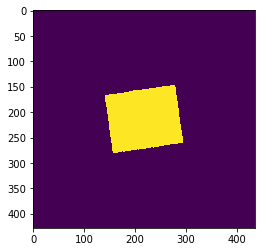

1 out of 152 R_LC08_L1GT_232017_20170619_20170619_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.598

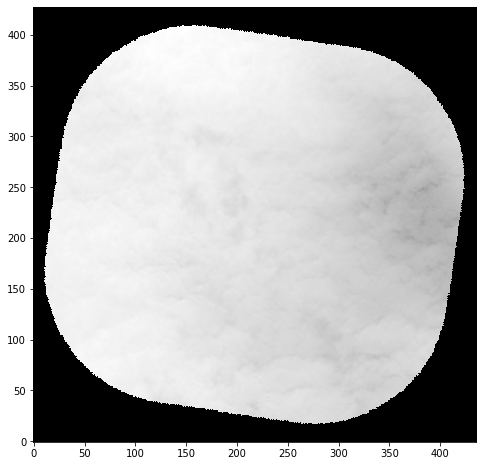

2 out of 152 R_LC08_L1GT_232017_20180825_20180825_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.598

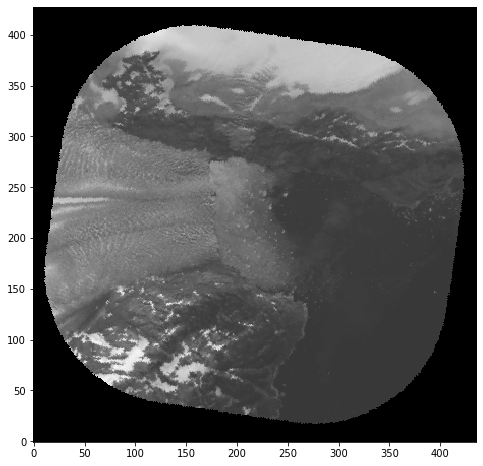

3 out of 152 R_LC08_L1GT_232017_20181012_20181012_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.598

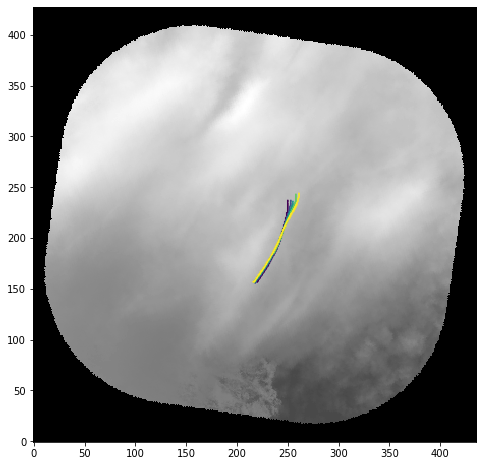

4 out of 152 R_LC08_L1GT_232017_20181231_20181231_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
13


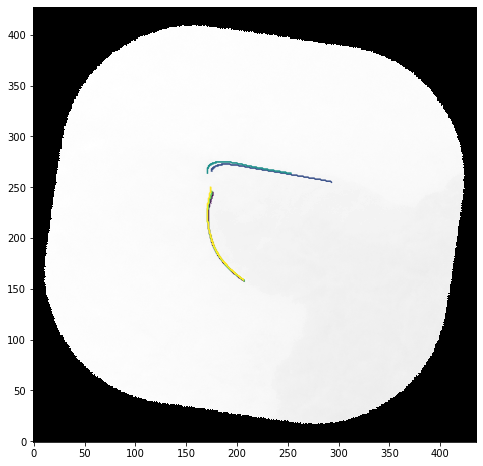

5 out of 152 R_LC08_L1TP_233017_20170306_20170316_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


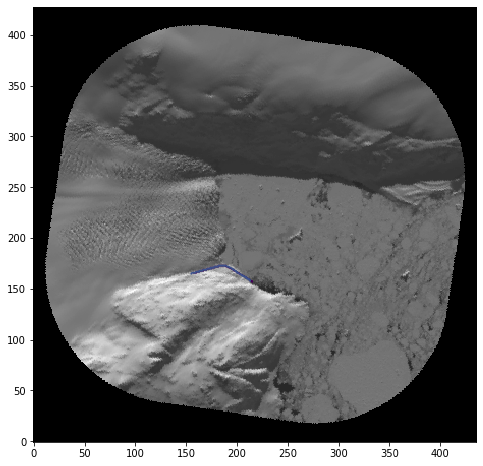

6 out of 152 R_LC08_L1TP_233017_20170407_20170414_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
27


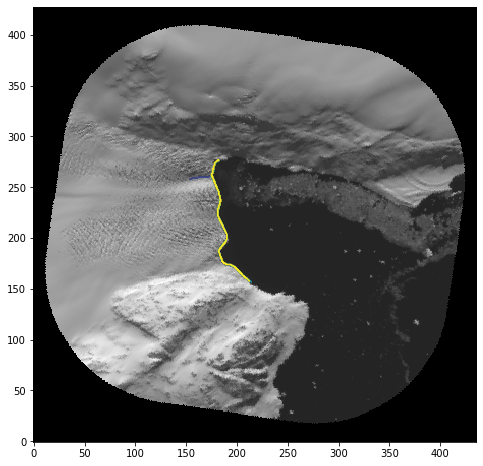

7 out of 152 R_LC08_L1TP_233017_20170509_20170509_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
32


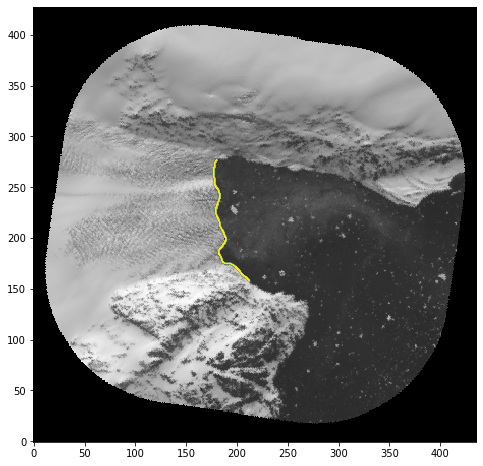

8 out of 152 R_LC08_L1TP_233017_20170509_20170516_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
32


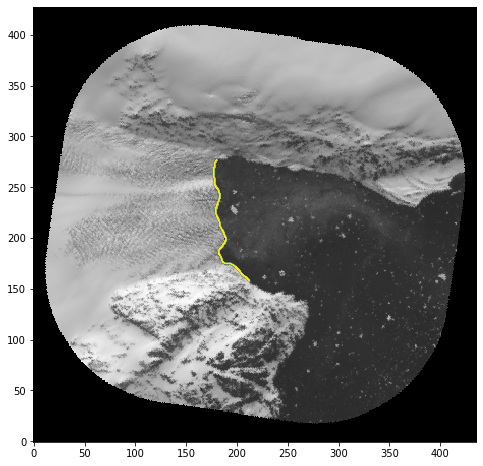

9 out of 152 R_LC08_L1TP_233017_20170525_20170525_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
6


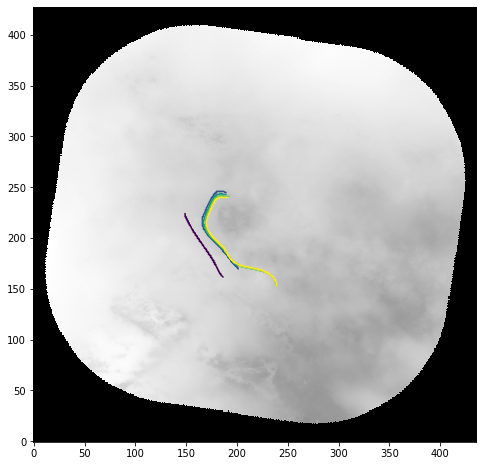

10 out of 152 R_LC08_L1TP_232017_20180214_20180214_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
8


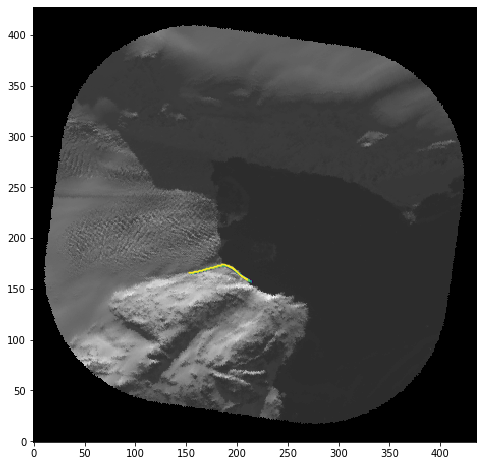

11 out of 152 R_LC08_L1TP_232017_20180214_20180222_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
7


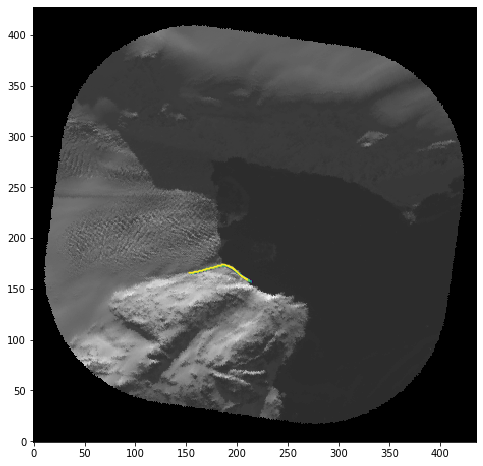

12 out of 152 R_LC08_L1TP_232017_20180302_20180302_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
16


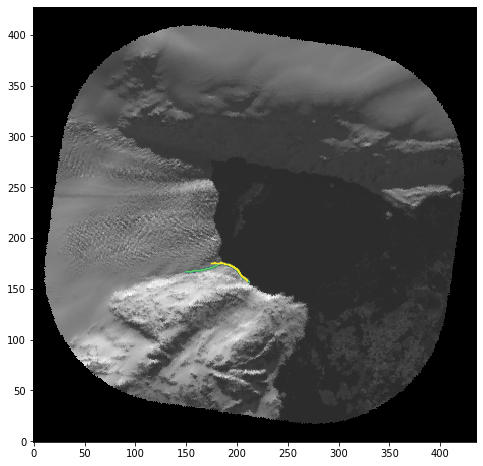

13 out of 152 R_LC08_L1TP_232017_20180302_20180319_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
16


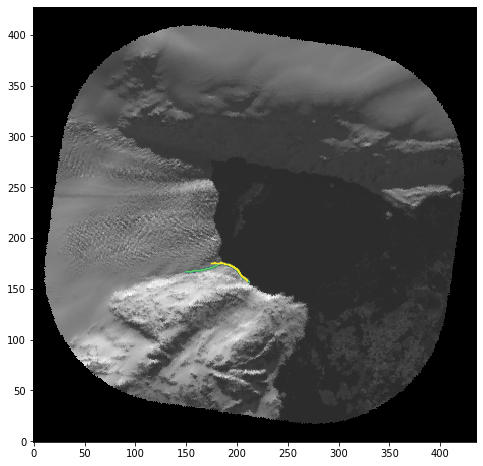

14 out of 152 R_LC08_L1TP_232017_20180505_20180506_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


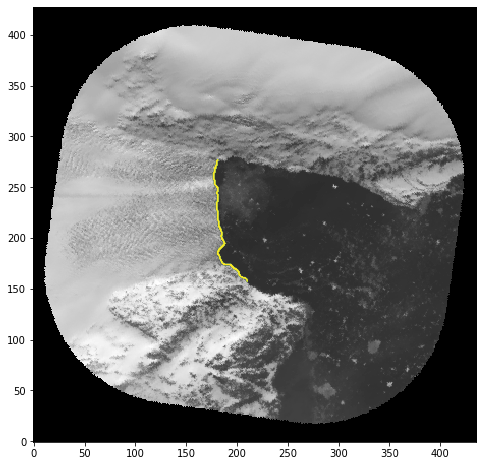

15 out of 152 R_LC08_L1TP_232017_20160702_20170323_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
12


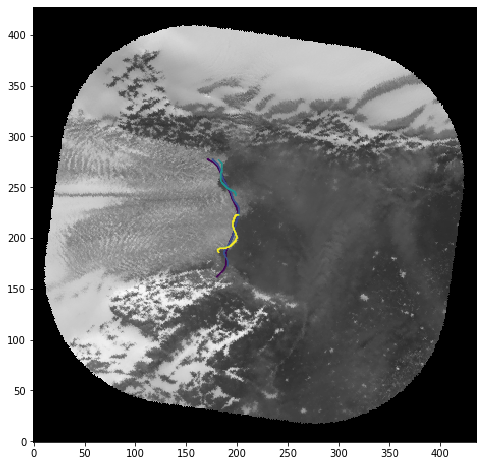

16 out of 152 R_LC08_L1TP_233017_20180325_20180325_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
11


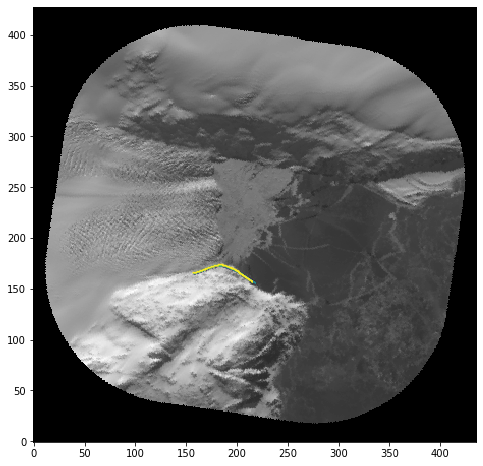

17 out of 152 R_LC08_L1TP_233017_20180325_20180404_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
16


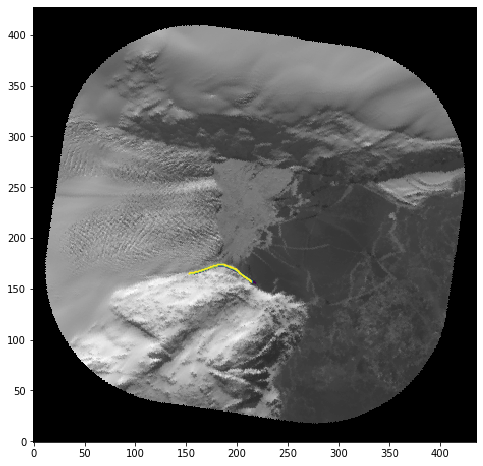

18 out of 152 R_LC08_L1TP_233017_20180426_20180426_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


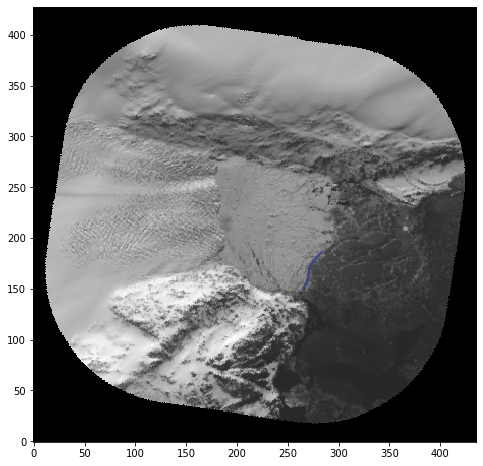

19 out of 152 R_LC08_L1TP_233017_20180426_20180502_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


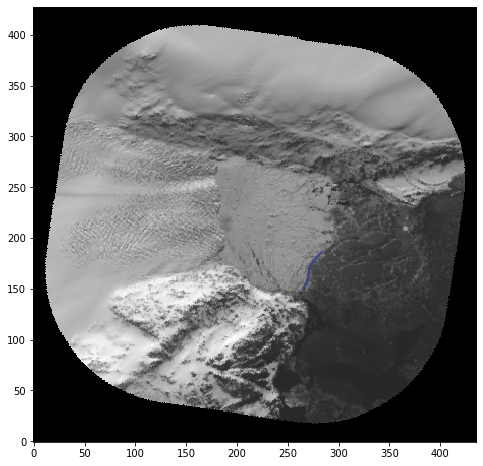

20 out of 152 R_LC08_L1TP_233017_20180528_20180528_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
43


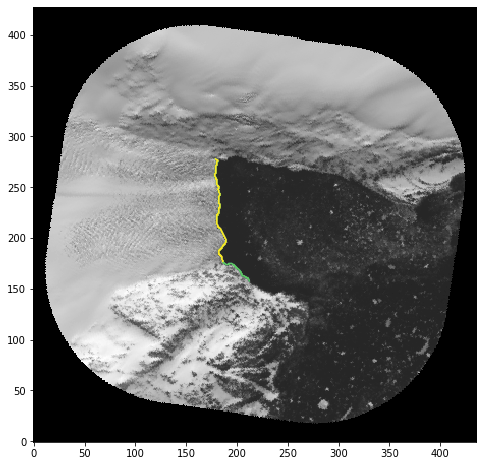

21 out of 152 R_LC08_L1TP_232017_20150716_20170407_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


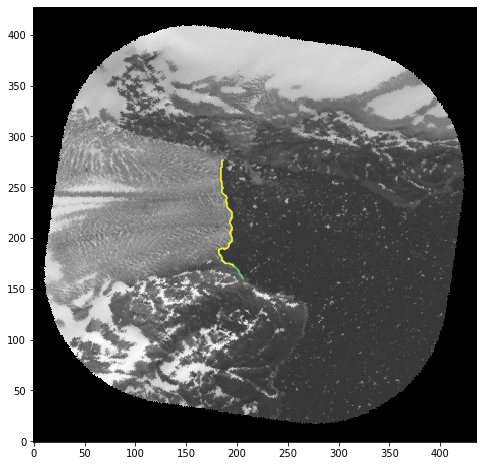

22 out of 152 R_LC08_L1TP_232017_20150801_20170406_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
40


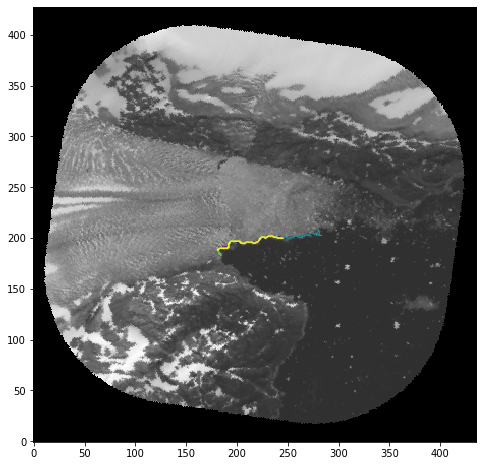

23 out of 152 R_LC08_L1TP_232017_20151004_20170403_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


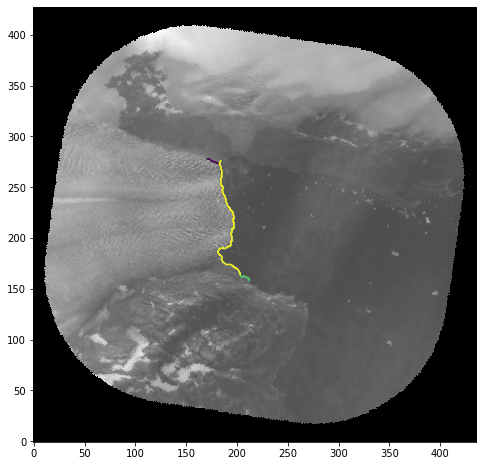

24 out of 152 R_LC08_L1TP_232017_20160413_20170326_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


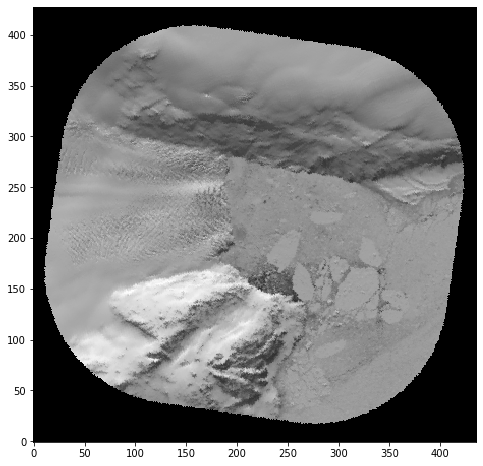

25 out of 152 R_LC08_L1TP_233017_20130530_20170504_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

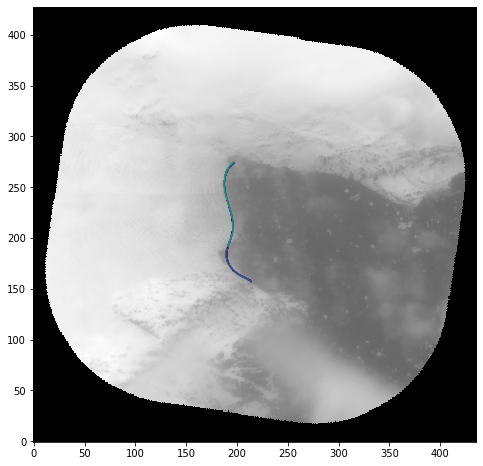

26 out of 152 R_LC08_L1TP_233017_20130818_20180426_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
31


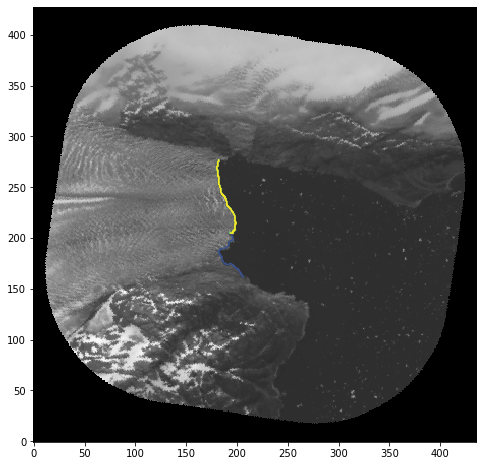

27 out of 152 R_LC08_L1TP_233017_20130903_20170502_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


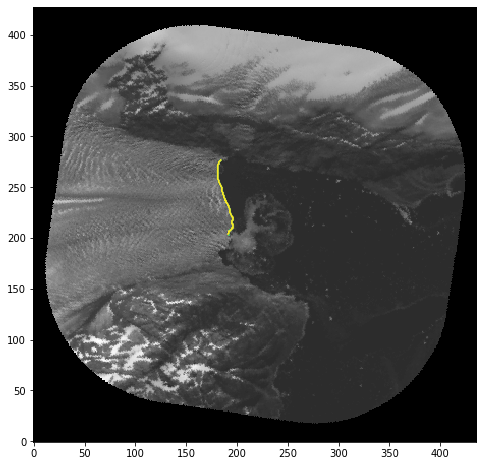

28 out of 152 R_LC08_L1TP_233017_20131021_20170429_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
19


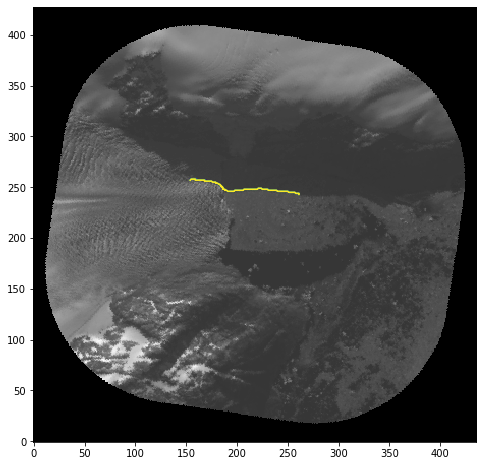

29 out of 152 R_LC08_L1TP_233017_20131106_20170428_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
9


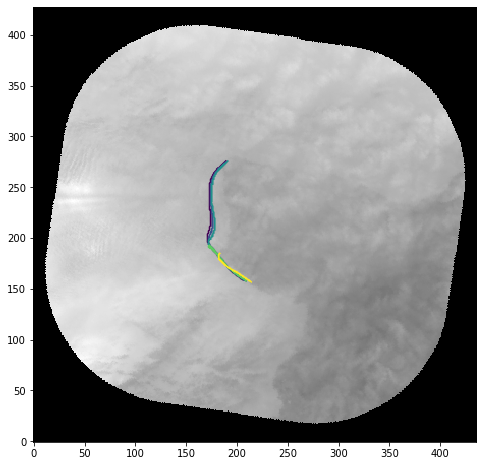

30 out of 152 R_LC08_L1TP_232017_20190609_20190609_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


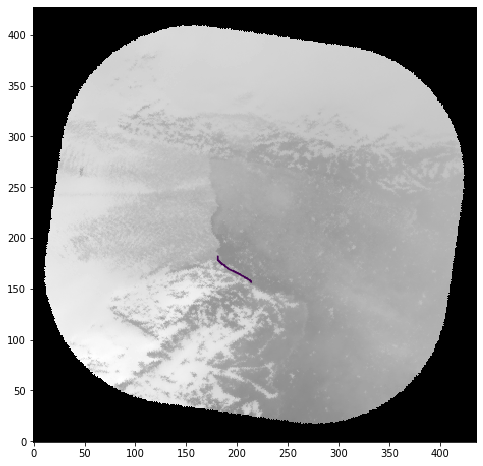

31 out of 152 R_LC08_L1TP_232017_20190625_20190625_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


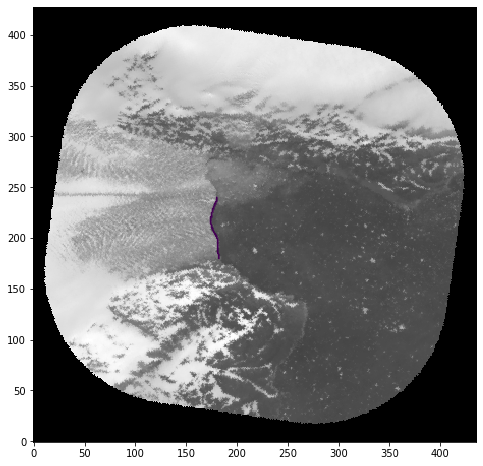

32 out of 152 R_LC08_L1TP_232017_20190625_20190705_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


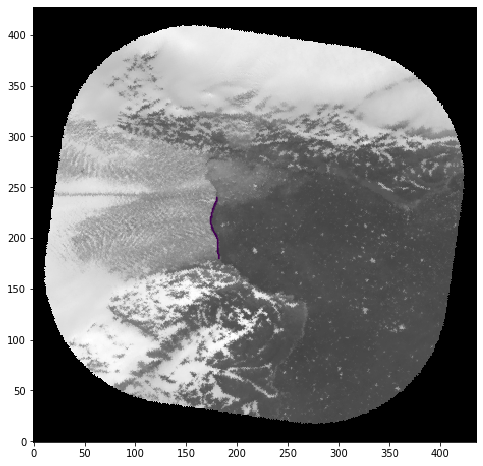

33 out of 152 R_LC08_L1TP_232017_20190711_20190711_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
3


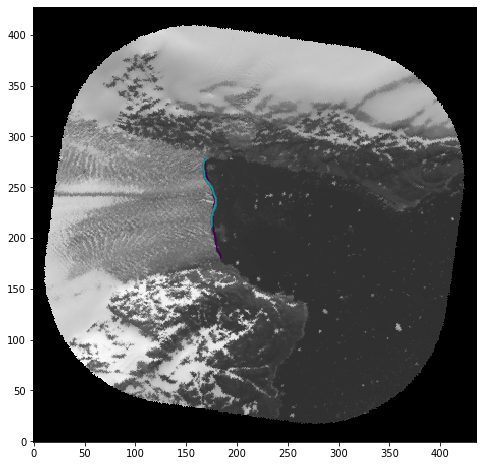

34 out of 152 R_LC08_L1TP_233017_20190718_20190731_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


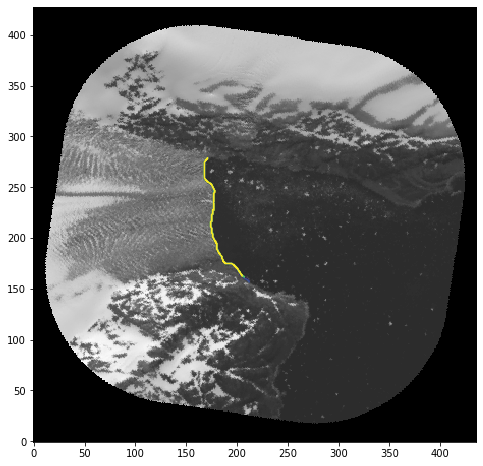

35 out of 152 R_LC08_L1TP_233017_20190803_20190803_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


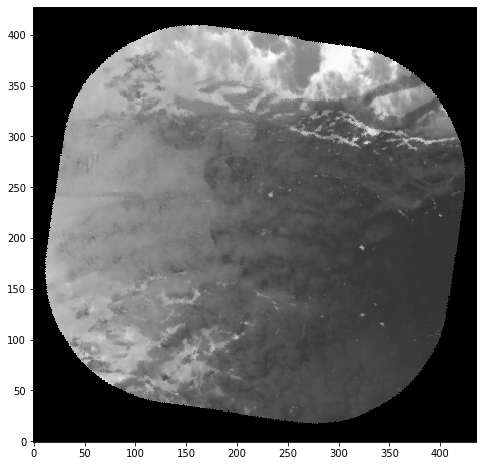

36 out of 152 R_LC08_L1TP_233017_20190803_20190819_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

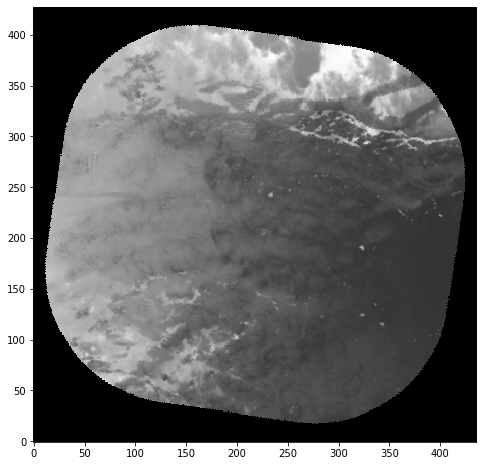

37 out of 152 R_LC08_L1TP_233017_20191022_20191022_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

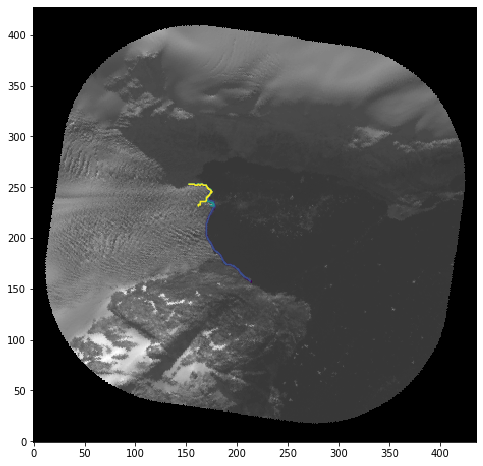

38 out of 152 R_LC08_L1TP_233017_20191022_20191030_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
28


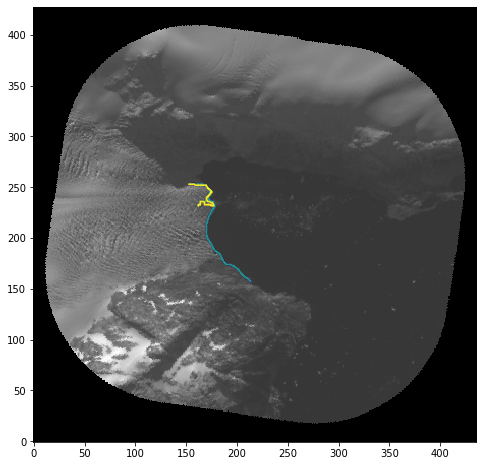

39 out of 152 R_LC08_L1TP_233017_20150808_20180528_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
27


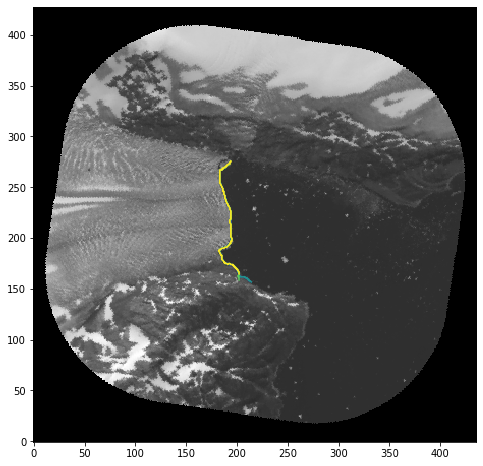

40 out of 152 R_LC08_L1TP_233017_20150824_20170405_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
37


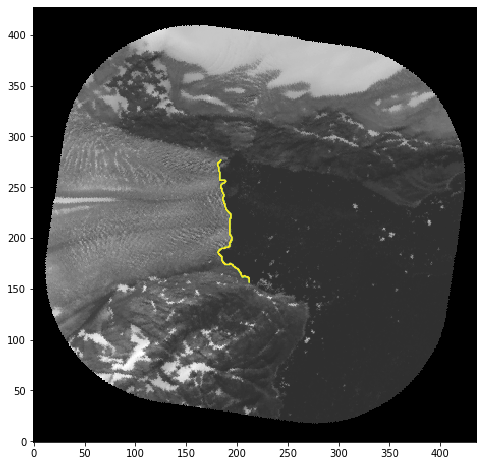

41 out of 152 R_LC08_L1TP_233017_20150909_20170404_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
45


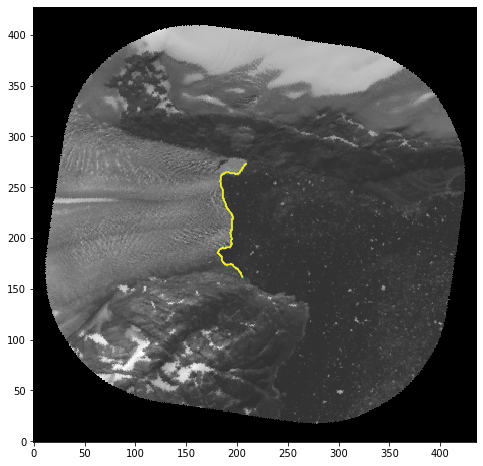

42 out of 152 R_LC08_L1TP_233017_20150925_20170403_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
45


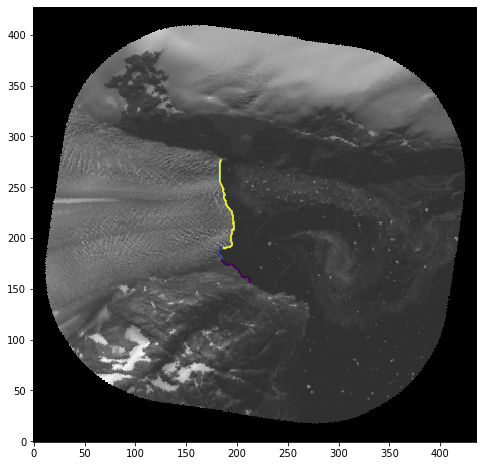

43 out of 152 R_LC08_L1TP_233017_20160216_20170329_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
21


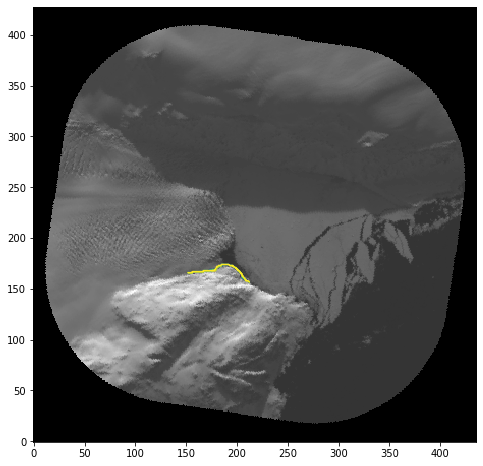

44 out of 152 R_LC08_L1TP_233017_20170728_20170810_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


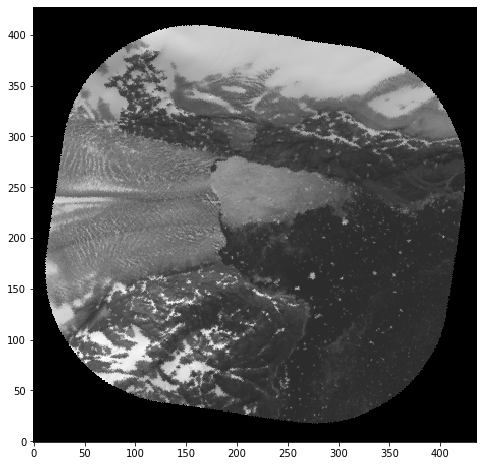

45 out of 152 R_LC08_L1TP_233017_20170813_20170814_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

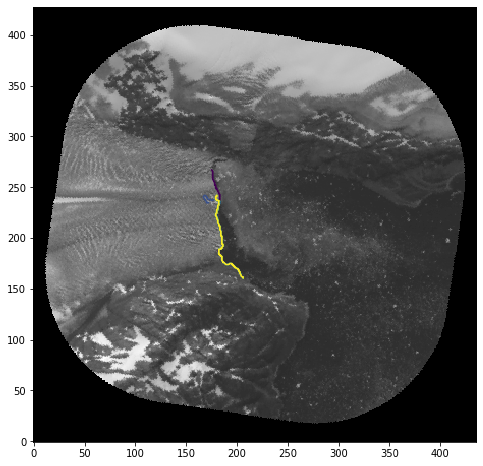

46 out of 152 R_LC08_L1TP_233017_20170813_20170825_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
23


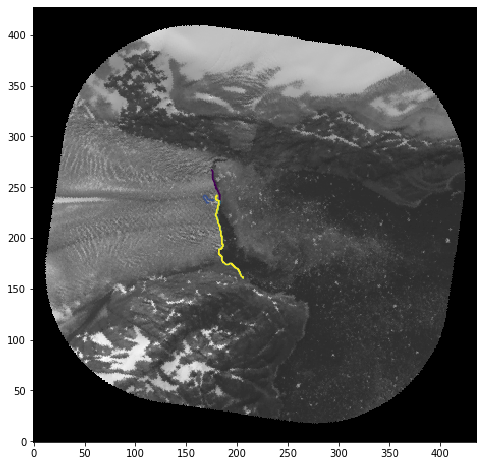

47 out of 152 R_LC08_L1TP_233017_20170829_20170829_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
19


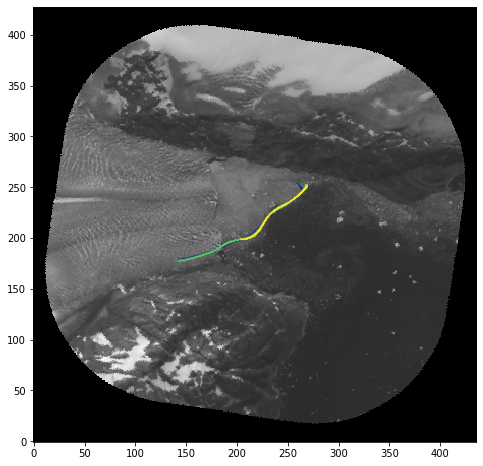

48 out of 152 R_LC08_L1TP_233017_20170829_20170914_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
19


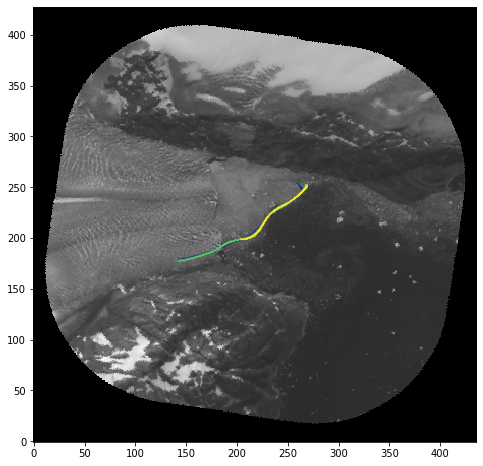

49 out of 152 R_LC08_L1TP_233017_20180901_20180901_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


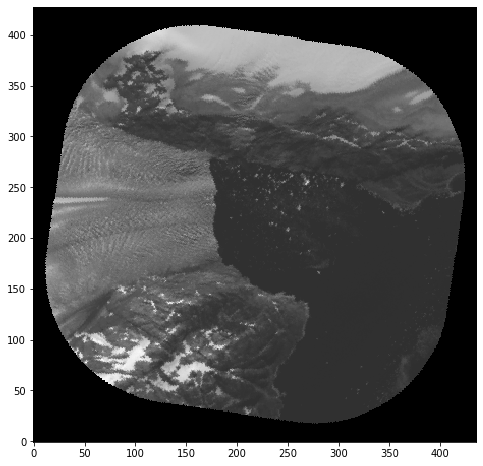

50 out of 152 R_LC08_L1TP_233017_20180901_20180912_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

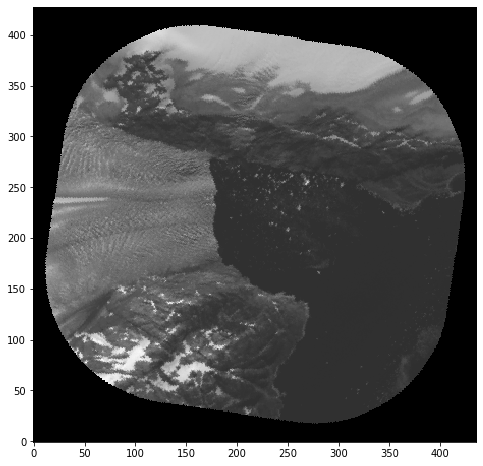

51 out of 152 R_LC08_L1TP_233017_20181003_20181003_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

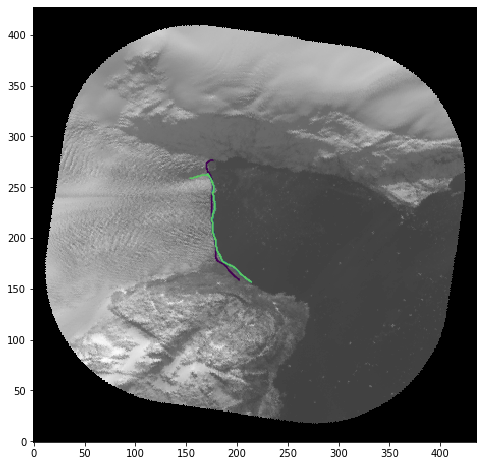

52 out of 152 R_LC08_L1TP_233017_20181003_20181010_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
4


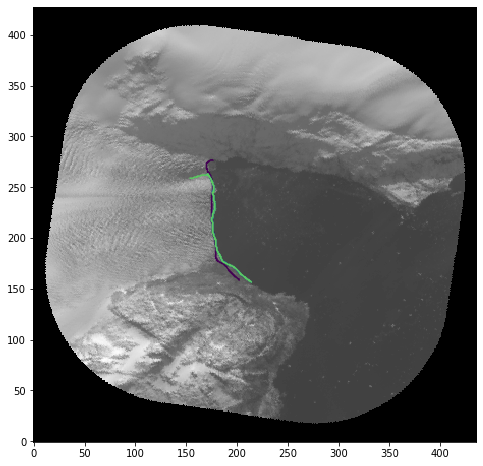

53 out of 152 R_LC08_L1TP_233017_20181104_20181104_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
35


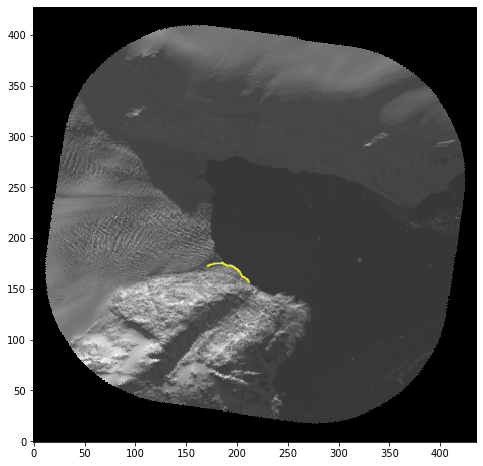

54 out of 152 R_LC08_L1TP_232017_20130928_20180528_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
45


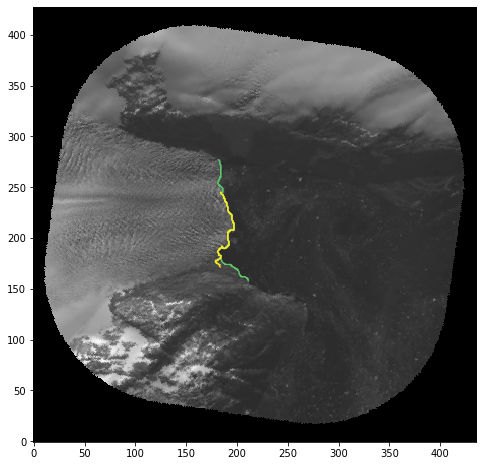

55 out of 152 R_LC08_L1TP_232017_20140526_20170422_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
5


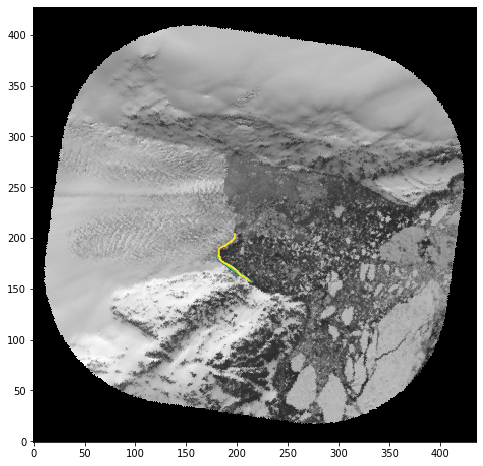

56 out of 152 R_LC08_L1TP_232017_20140713_20170421_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


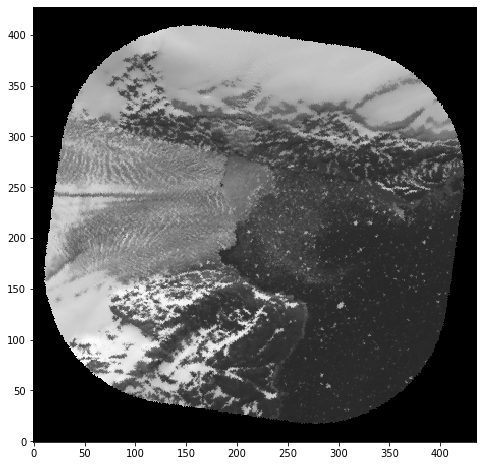

57 out of 152 R_LC08_L1TP_232017_20140729_20170420_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

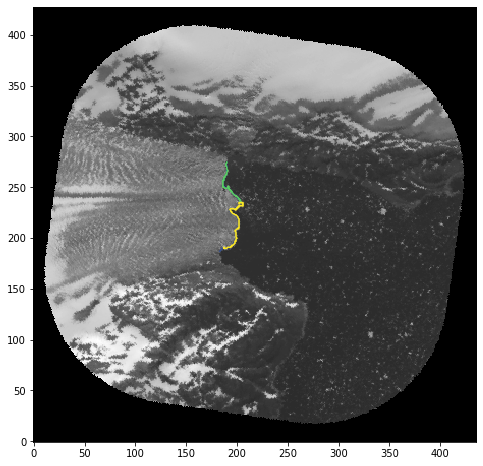

58 out of 152 R_LC08_L1TP_232017_20140915_20170419_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
42


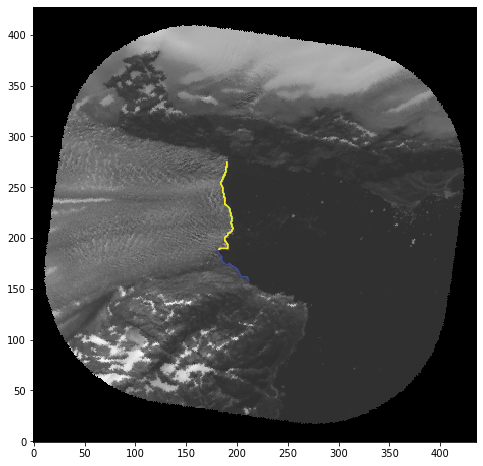

59 out of 152 R_LC08_L1TP_232017_20170331_20170414_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
23


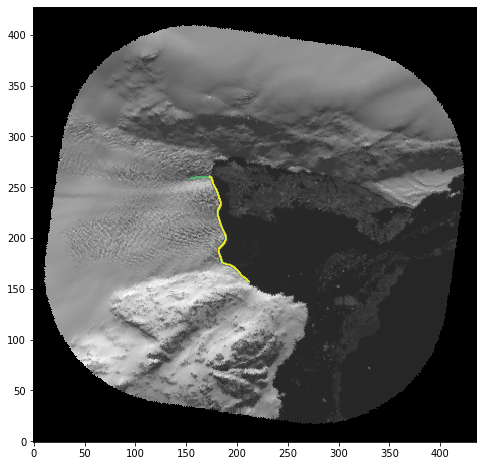

60 out of 152 R_LC08_L1TP_232017_20170907_20170907_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
35


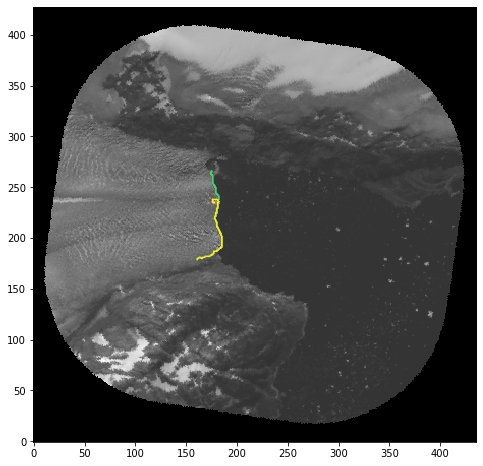

61 out of 152 R_LC08_L1TP_232017_20170907_20170926_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
35


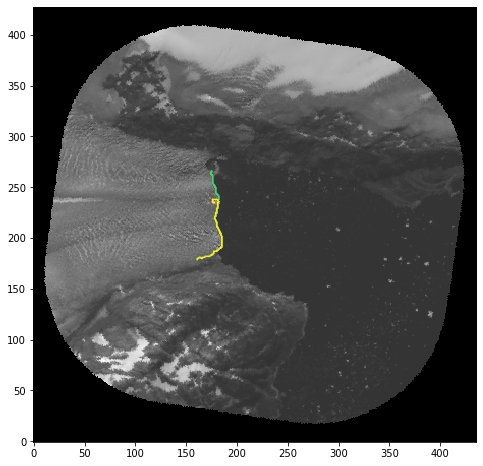

62 out of 152 R_LC08_L1TP_232017_20170923_20170923_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
45


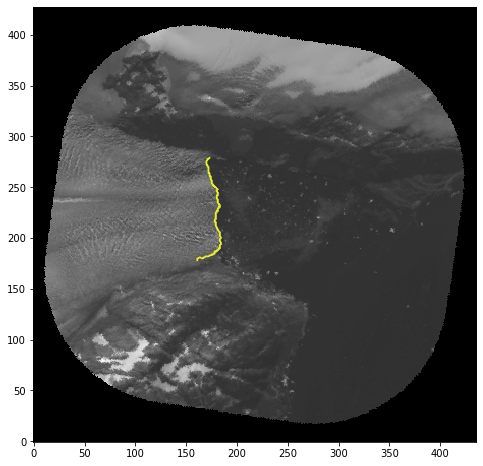

63 out of 152 R_LC08_L1TP_232017_20170923_20171013_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
44


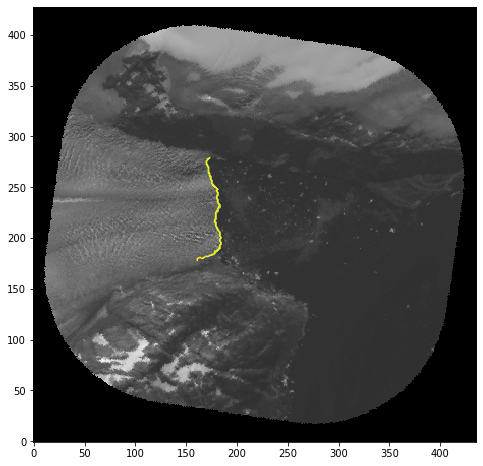

64 out of 152 R_LC08_L1TP_232017_20180910_20180910_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
38


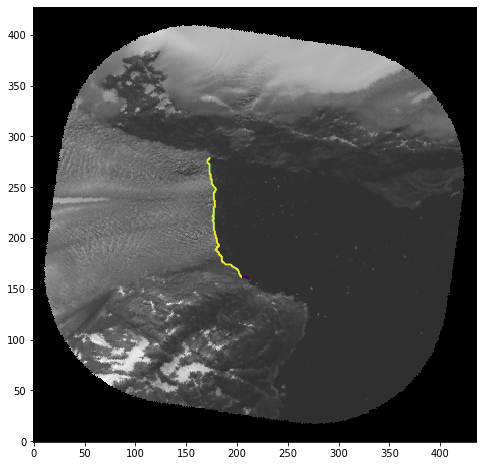

65 out of 152 R_LC08_L1TP_232017_20180910_20180927_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
38


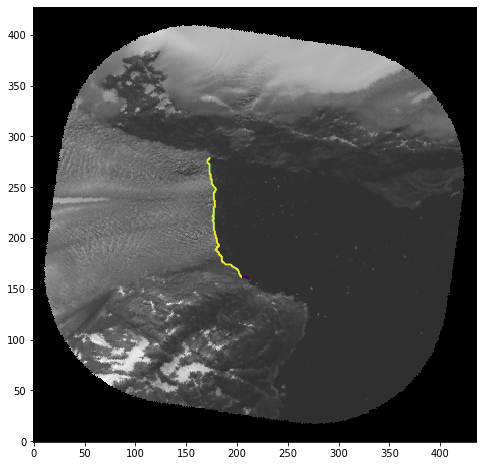

66 out of 152 R_LC08_L1TP_232017_20180926_20180926_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
4


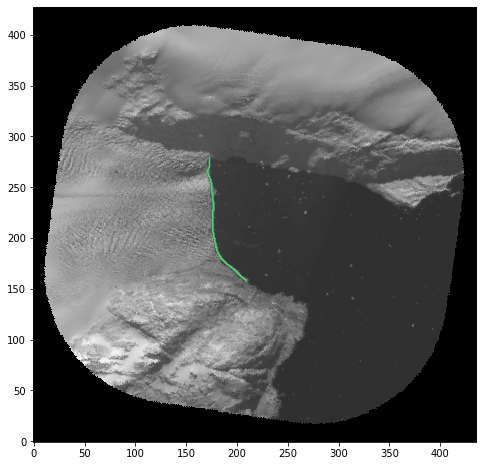

67 out of 152 R_LC08_L1TP_232017_20180926_20181009_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
3


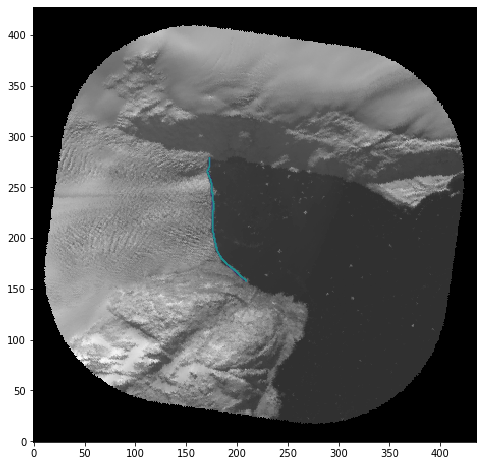

68 out of 152 R_LC08_L1TP_232017_20190913_20190913_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
20


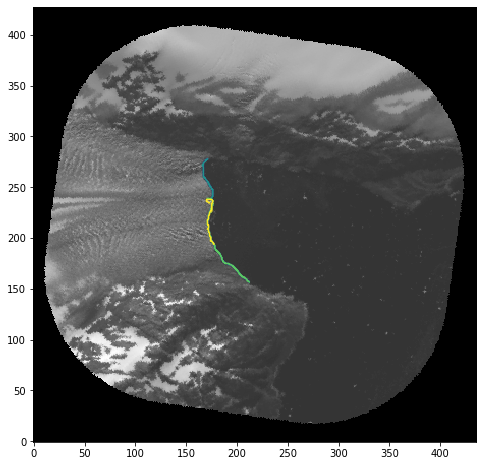

69 out of 152 R_LC08_L1TP_232017_20190913_20190917_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
17


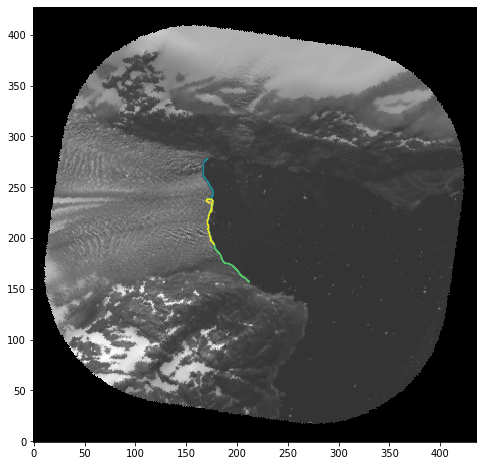

70 out of 152 R_LC08_L1TP_232017_20190929_20191001_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
25


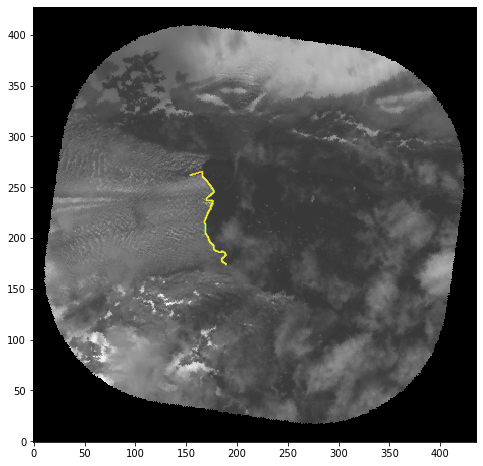

71 out of 152 R_LC08_L1TP_232017_20190929_20191017_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
25


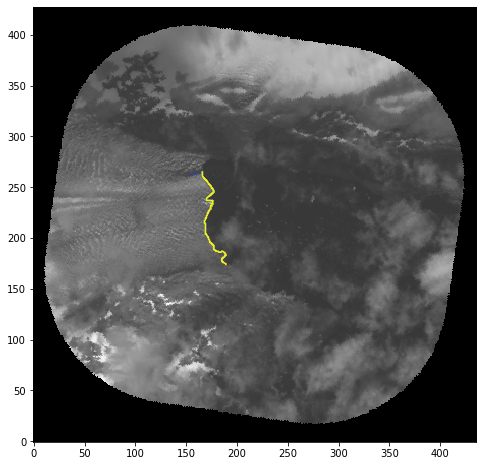

72 out of 152 R_LC08_L1TP_232017_20191015_20191015_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
23


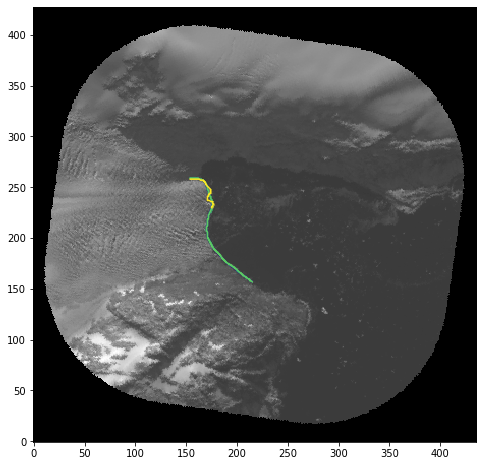

73 out of 152 R_LC08_L1TP_233017_20140415_20180426_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
36


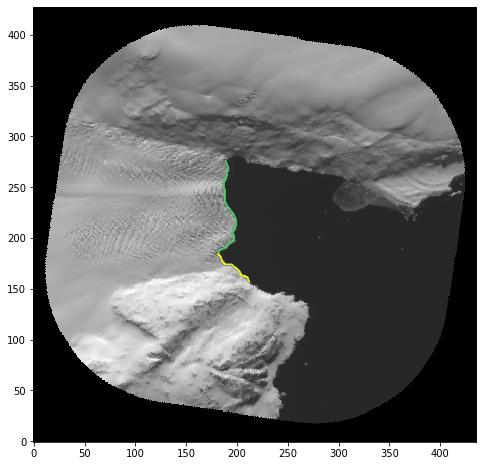

74 out of 152 R_LC08_L1TP_233017_20140517_20170422_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
37


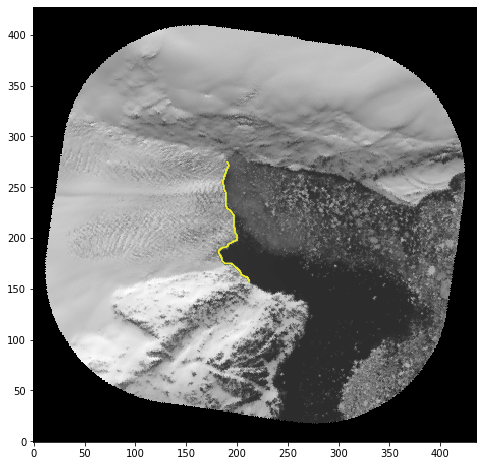

75 out of 152 R_LC08_L1TP_233017_20140602_20170422_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
6


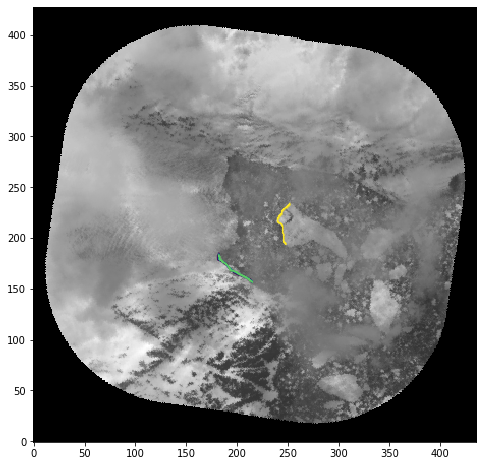

76 out of 152 R_LC08_L1TP_233017_20140720_20170421_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
6


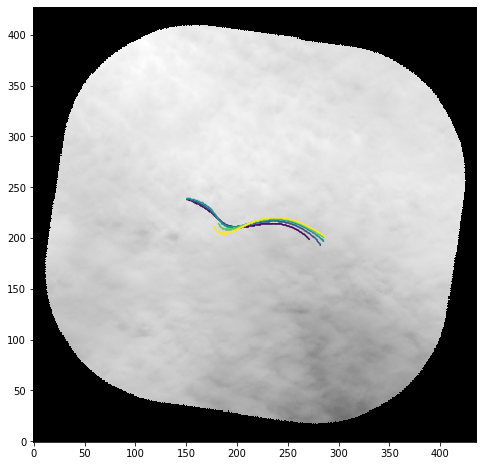

77 out of 152 R_LC08_L1TP_233017_20140821_20170420_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
39


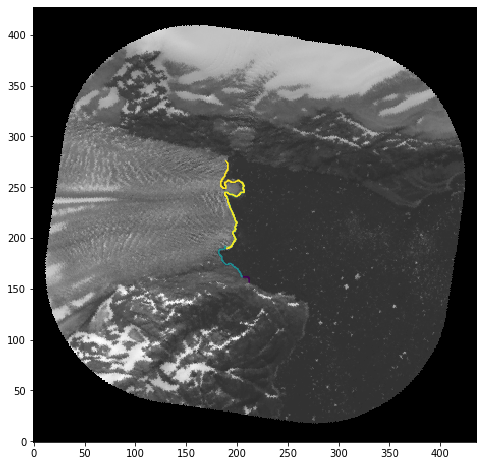

78 out of 152 R_LC08_L1TP_233017_20160420_20170326_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
24


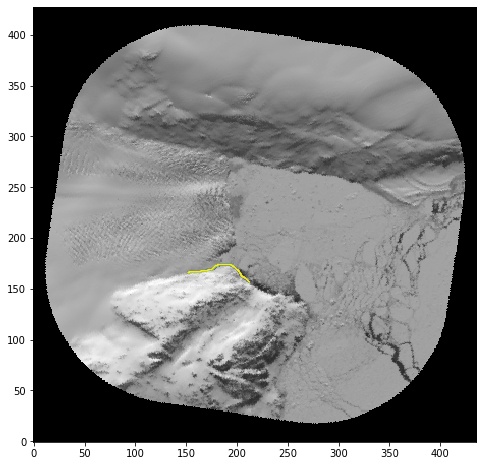

79 out of 152 R_LC08_L1TP_233017_20160506_20170325_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


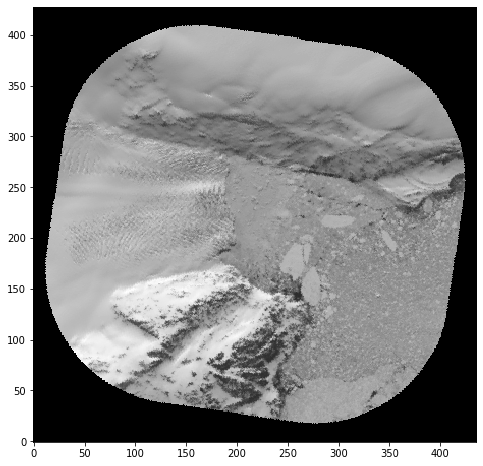

80 out of 152 R_LC08_L1TP_233017_20160623_20170323_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

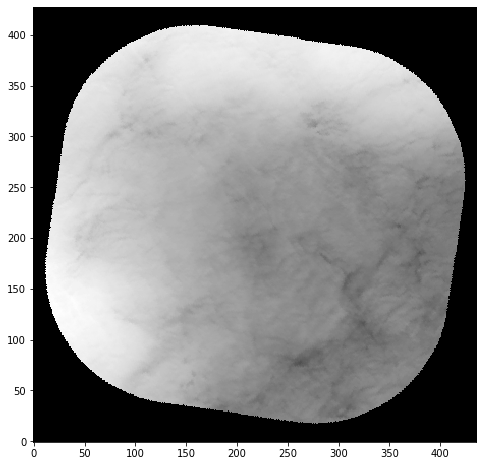

81 out of 152 R_LC08_L1TP_233017_20160725_20170322_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

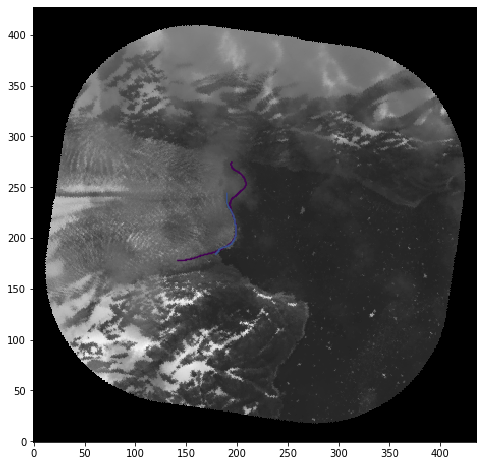

82 out of 152 R_LC08_L1TP_233017_20170525_20170614_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
6


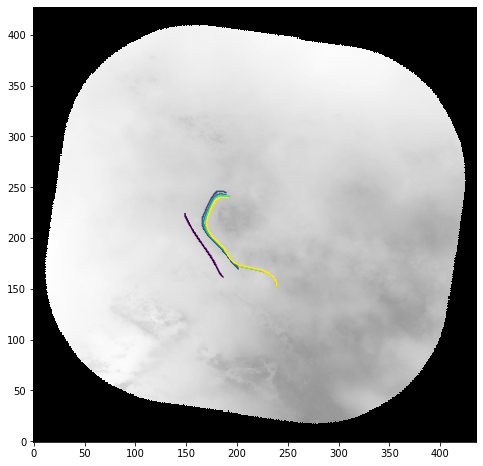

83 out of 152 R_LC08_L1TP_233017_20170610_20170610_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
36


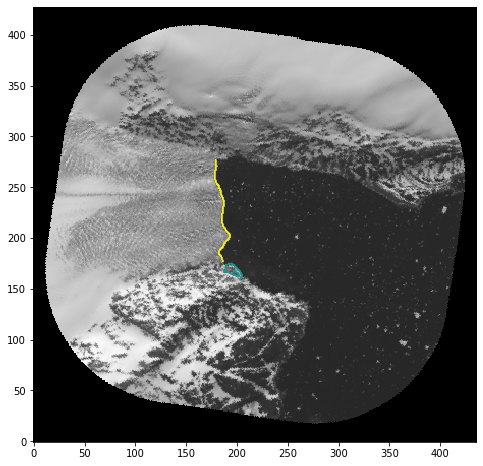

84 out of 152 R_LC08_L1TP_233017_20170610_20170627_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
36


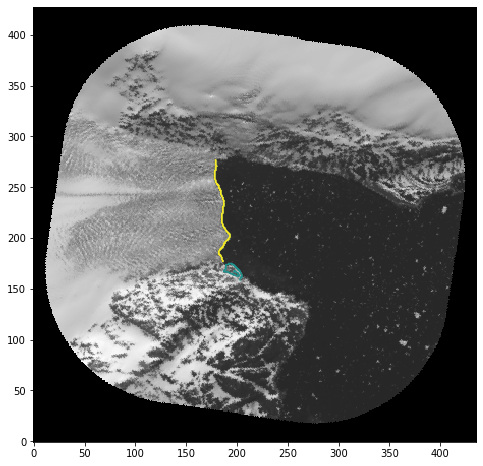

85 out of 152 R_LC08_L1TP_233017_20170712_20170712_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


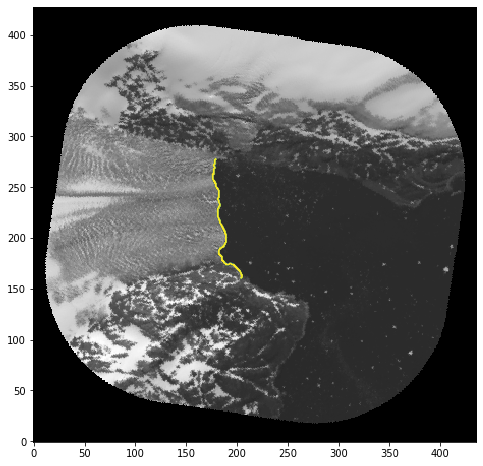

86 out of 152 R_LC08_L1TP_233017_20170712_20170726_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


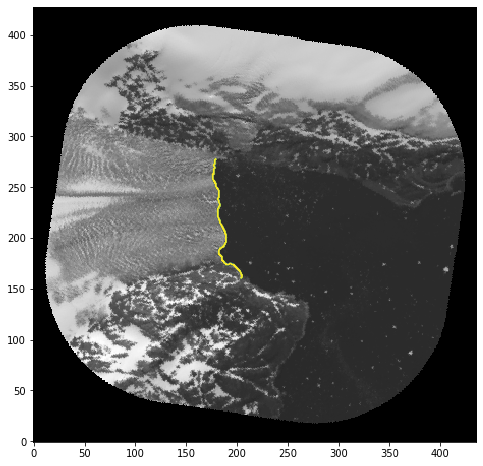

87 out of 152 R_LC08_L1TP_233017_20170728_20170729_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


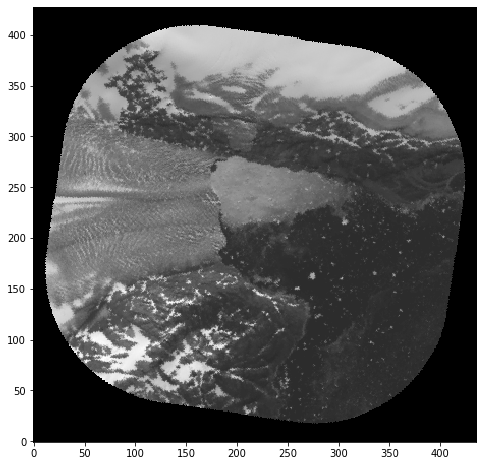

88 out of 152 R_LC08_L1TP_233017_20170930_20170930_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59

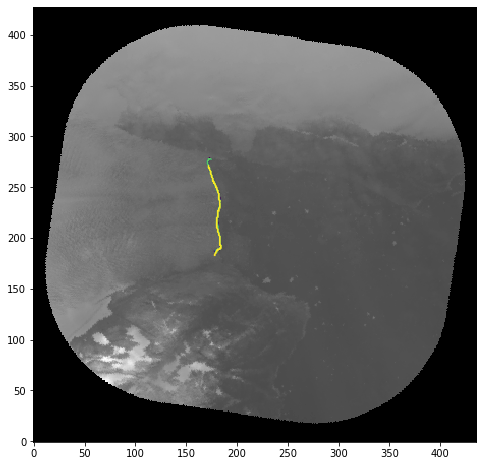

89 out of 152 R_LC08_L1TP_233017_20170930_20171013_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
20


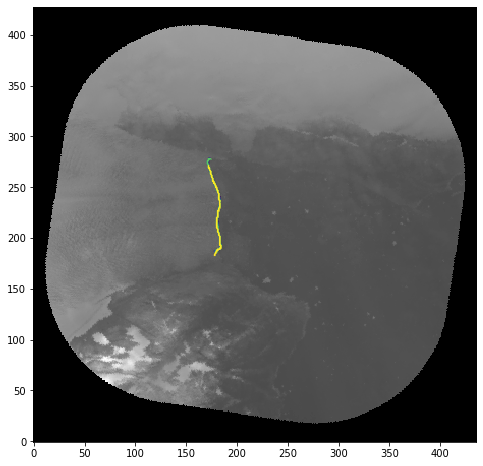

90 out of 152 R_LC08_L1TP_233017_20180205_20180205_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
13


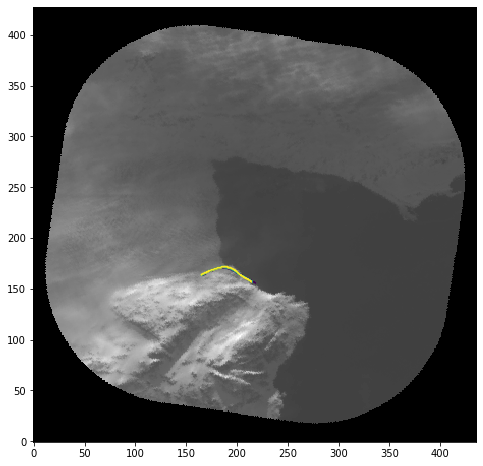

91 out of 152 R_LC08_L1TP_233017_20180205_20180221_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
12


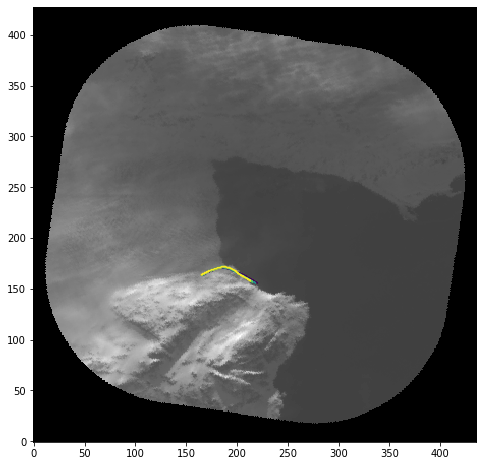

92 out of 152 R_LC08_L1TP_233017_20180221_20180221_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
16


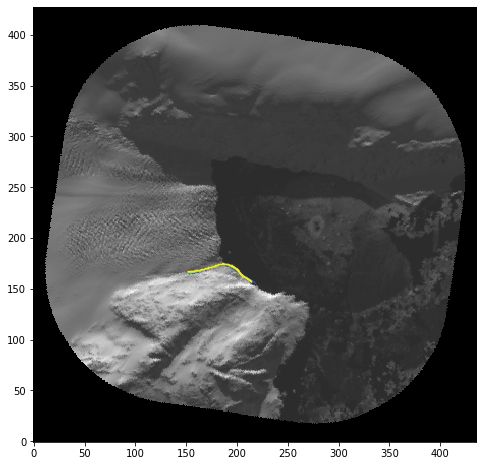

93 out of 152 R_LC08_L1TP_233017_20180221_20180308_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
16


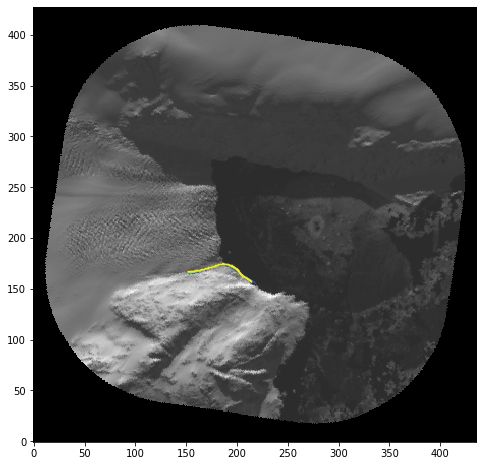

94 out of 152 R_LC08_L1TP_233017_20181104_20181115_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
36


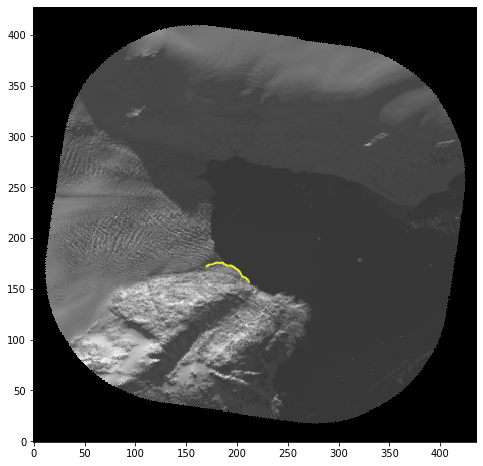

95 out of 152 R_LC08_L1TP_233017_20190328_20190328_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
6


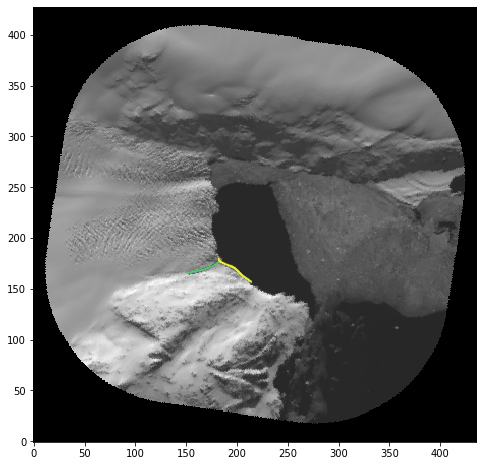

96 out of 152 R_LC08_L1TP_233017_20190328_20190404_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
7


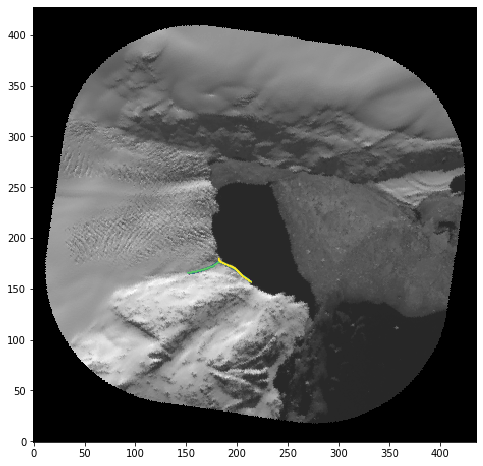

97 out of 152 R_LC08_L1TP_233017_20190531_20190531_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
18


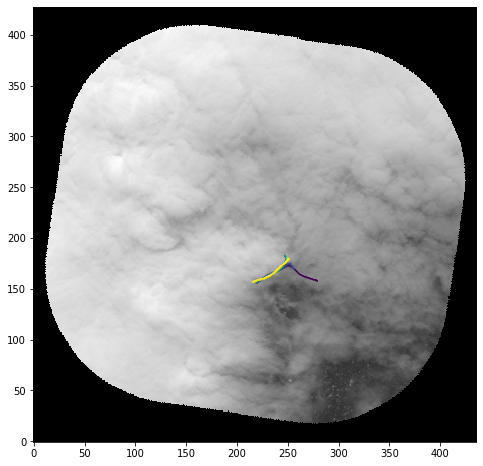

98 out of 152 R_LC08_L1TP_233017_20190531_20190605_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
18


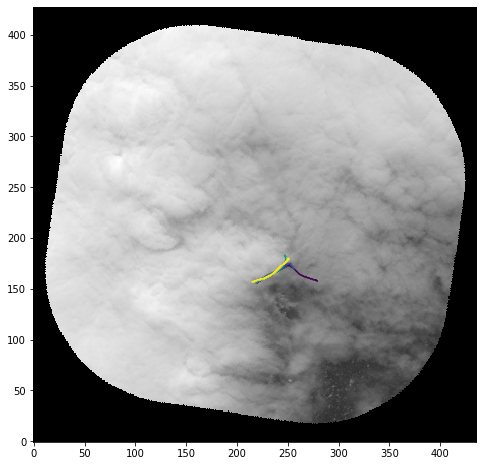

99 out of 152 R_LC08_L1TP_233017_20200110_20200110_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


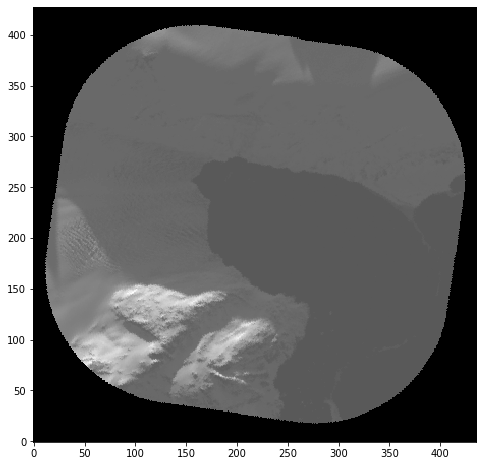

100 out of 152 R_LC08_L1TP_233017_20200211_20200211_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.5

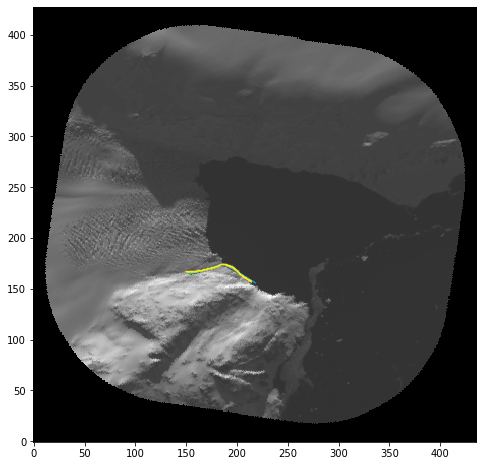

101 out of 152 R_LC08_L1TP_233017_20200211_20200225_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
18


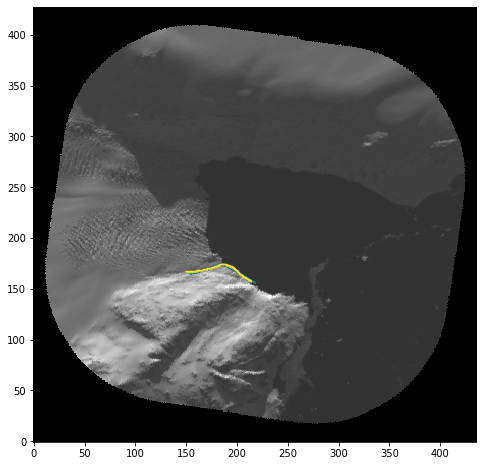

102 out of 152 R_LC08_L1TP_233017_20200314_20200315_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


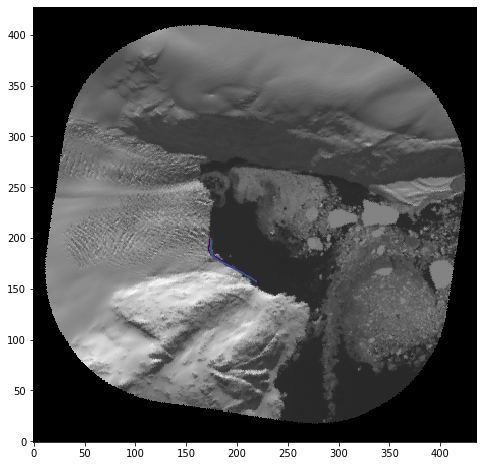

103 out of 152 R_LC08_L1TP_232017_20191015_20191029_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
23


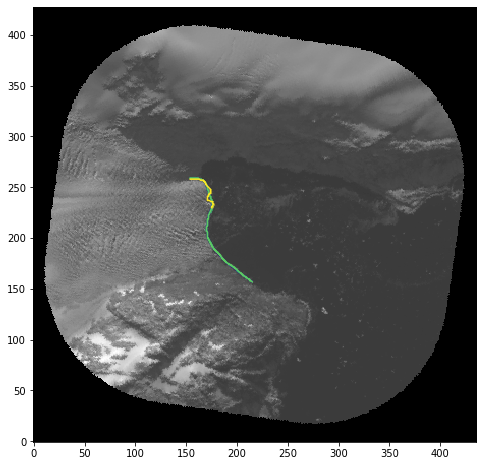

104 out of 152 R_LC08_L1TP_232017_20200119_20200119_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
18


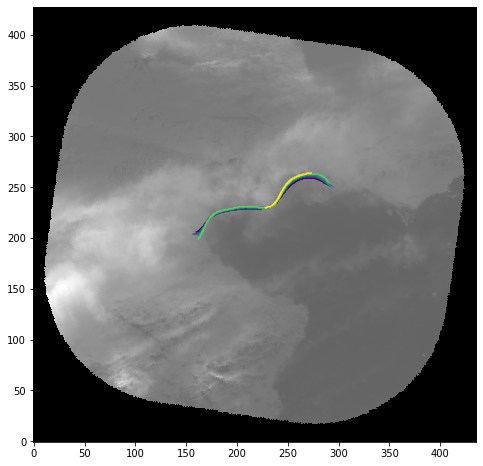

105 out of 152 R_LC08_L1TP_232017_20200323_20200323_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
24


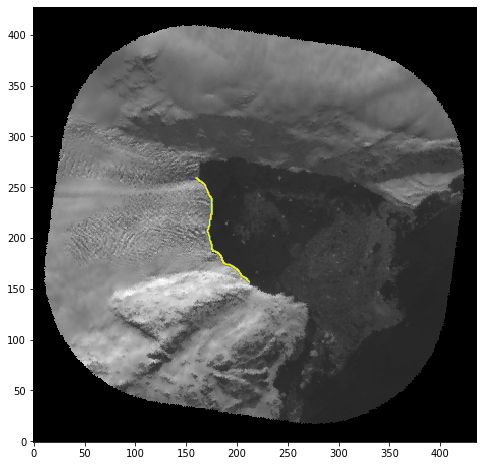

106 out of 152 R_LC08_L1TP_232017_20200323_20200326_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
24


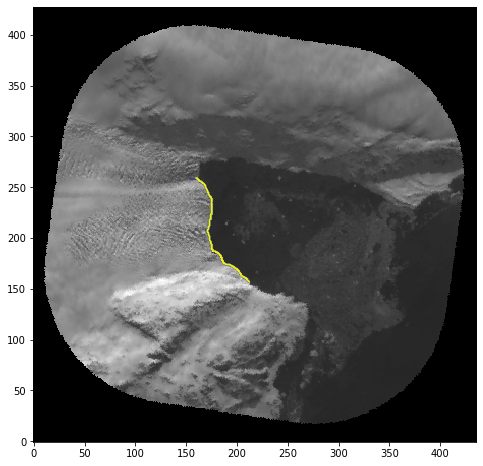

107 out of 152 R_LC08_L1TP_232017_20200408_20200408_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
19


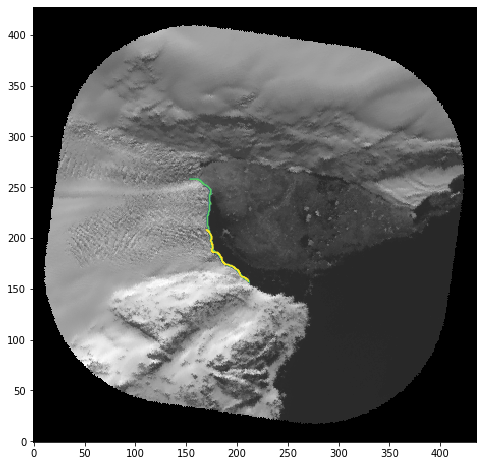

108 out of 152 R_LC08_L1TP_233017_20180528_20180605_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
43


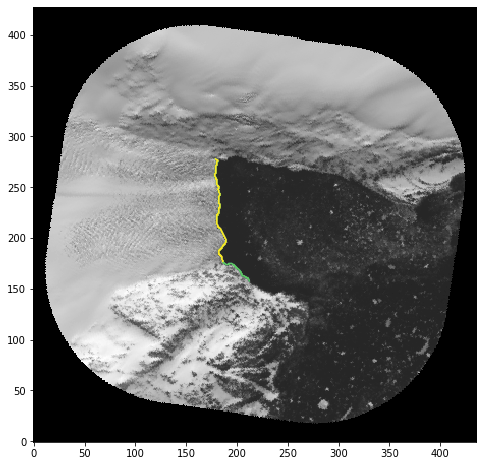

109 out of 152 R_LC08_L1TP_233017_20180613_20180613_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


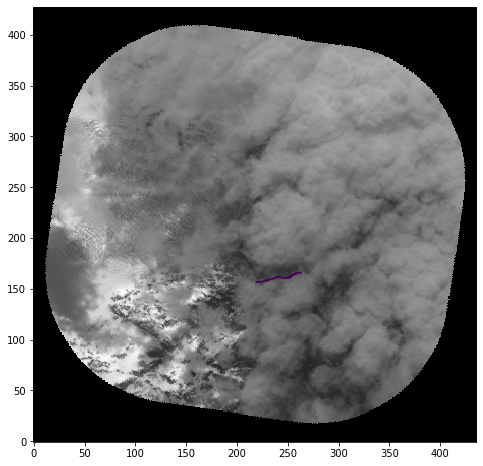

110 out of 152 R_LC08_L1TP_233017_20180613_20180703_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


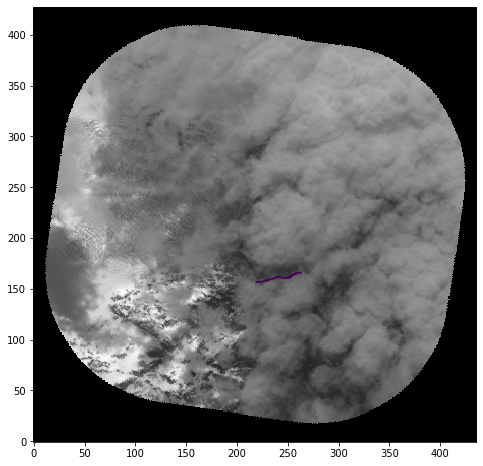

111 out of 152 R_LC08_L1TP_233017_20180629_20180629_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
31


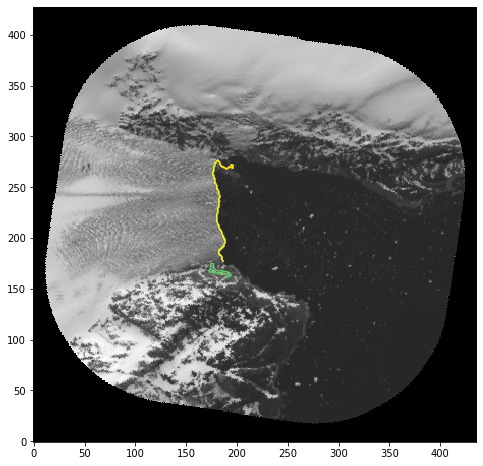

112 out of 152 R_LC08_L1TP_233017_20180629_20180716_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
33


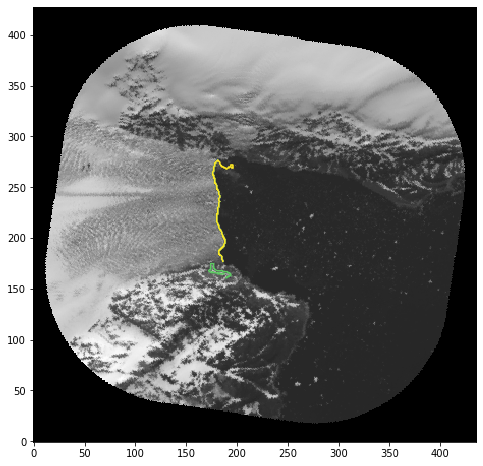

113 out of 152 R_LC08_L1TP_233017_20140906_20170419_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
20


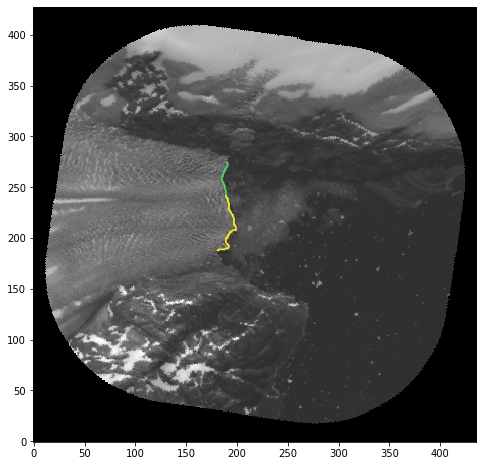

114 out of 152 R_LC08_L1TP_233017_20140922_20170419_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
18


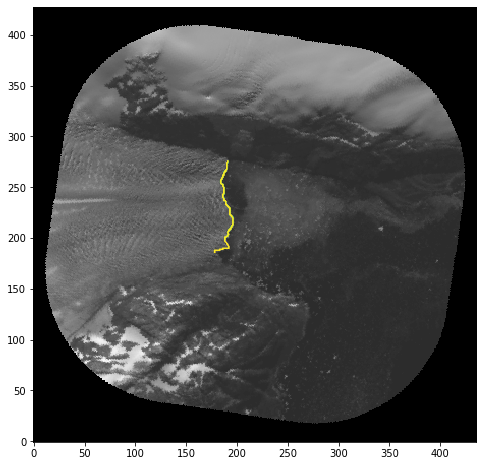

115 out of 152 R_LC08_L1TP_233017_20141024_20170418_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
32


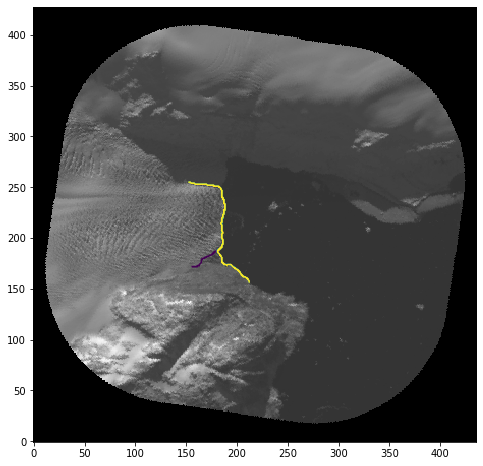

116 out of 152 R_LC08_L1TP_233017_20150128_20170413_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
25


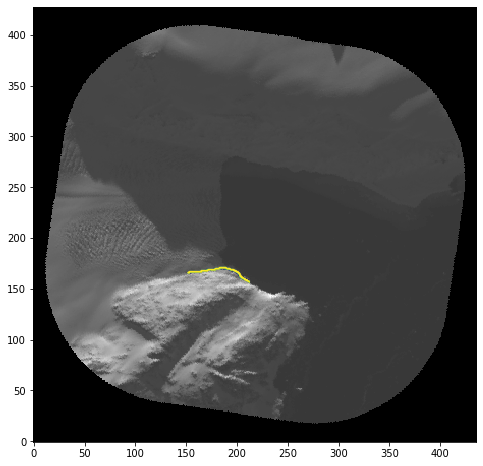

117 out of 152 R_LC08_L1TP_233017_20150520_20170408_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
39


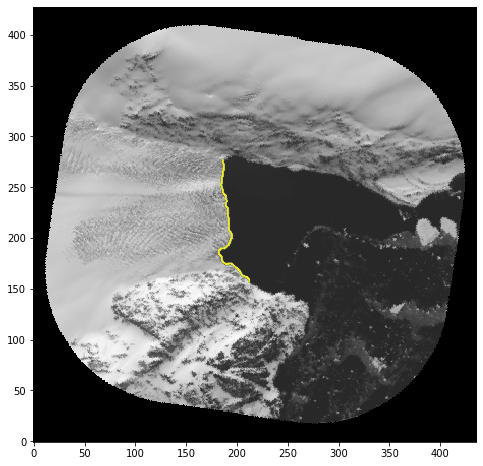

118 out of 152 R_LC08_L1TP_232017_20171025_20171025_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
43


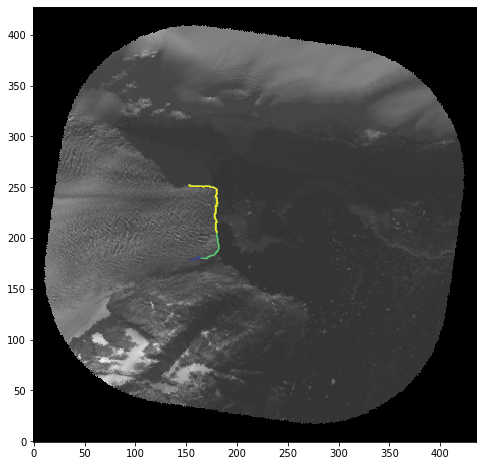

119 out of 152 R_LC08_L1TP_232017_20171025_20171107_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
43


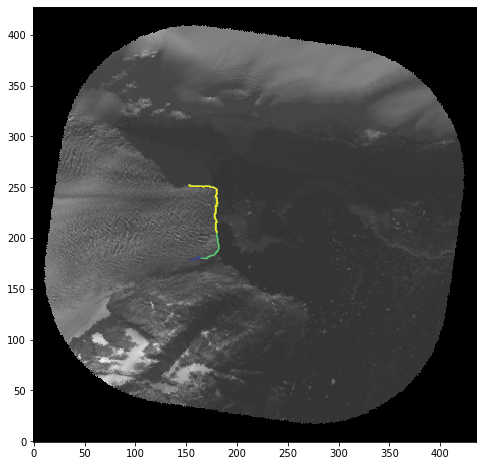

120 out of 152 R_LC08_L1TP_232017_20171110_20171110_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


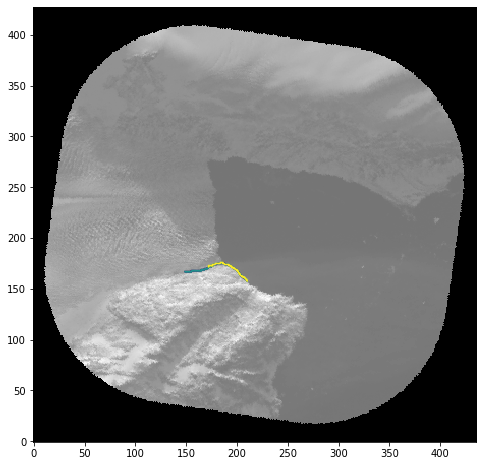

121 out of 152 R_LC08_L1TP_232017_20171110_20171121_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


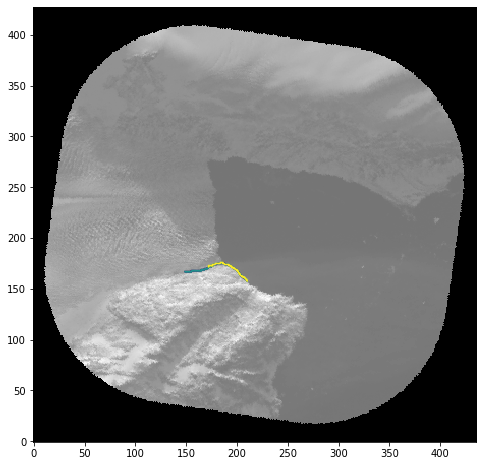

122 out of 152 R_LC08_L1TP_232017_20180113_20180113_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
11


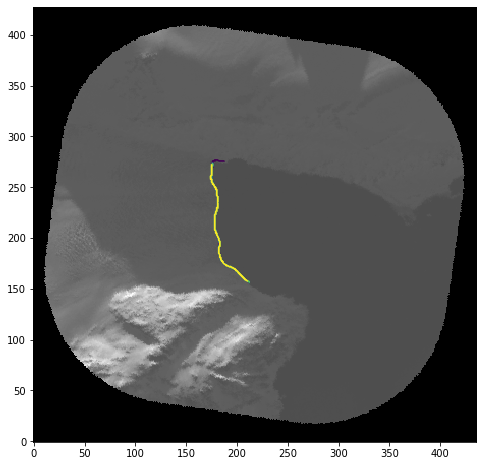

123 out of 152 R_LC08_L1GT_232017_20190508_20190508_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


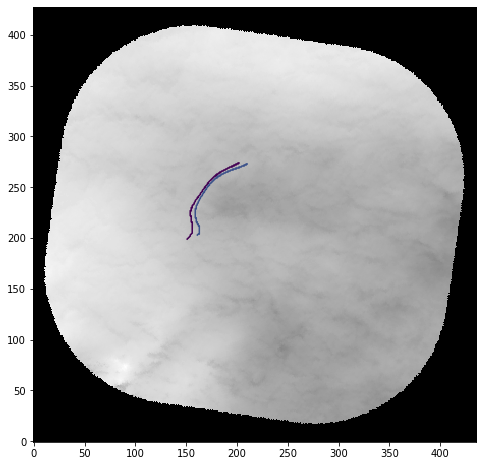

124 out of 152 R_LC08_L1GT_232017_20190727_20190727_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
14


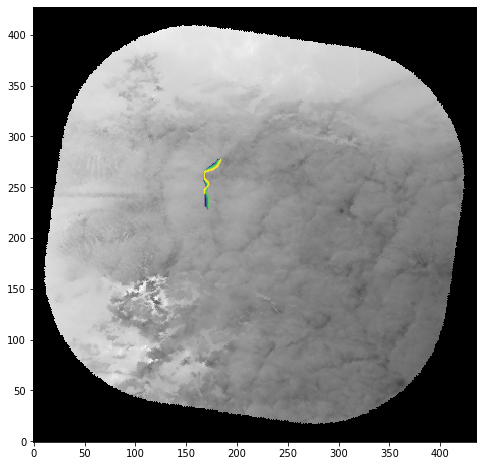

125 out of 152 R_LC08_L1GT_233017_20170626_20170626_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
44


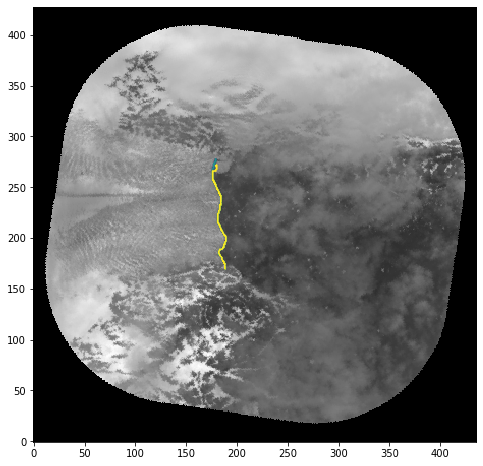

126 out of 152 R_LC08_L1GT_233017_20171203_20171203_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


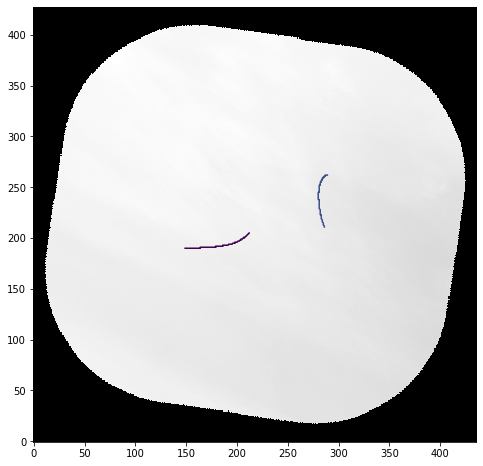

127 out of 152 R_LC08_L1GT_233017_20191209_20191209_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
1


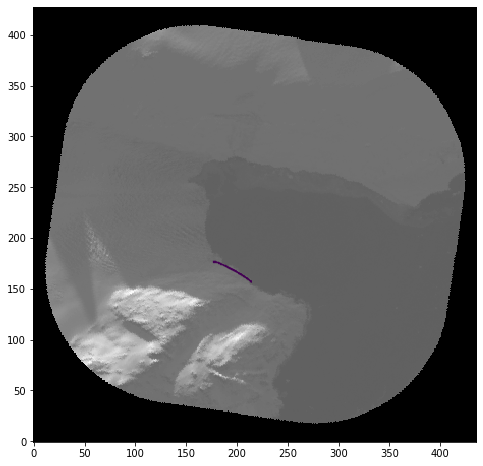

128 out of 152 R_LC08_L1TP_232017_20141001_20170418_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


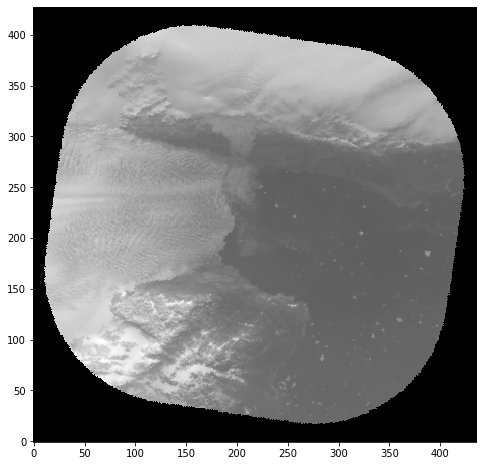

129 out of 152 R_LC08_L1TP_232017_20141102_20180528_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.5

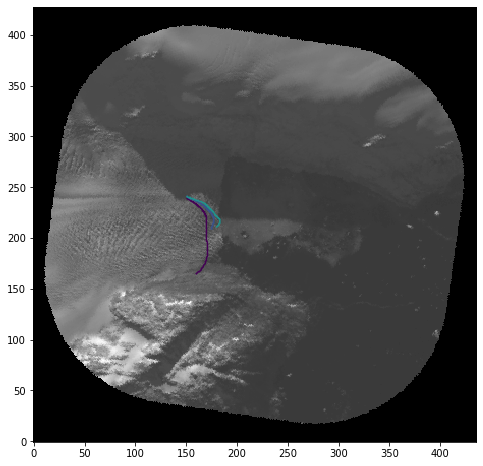

130 out of 152 R_LC08_L1TP_232017_20141204_20170416_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
17


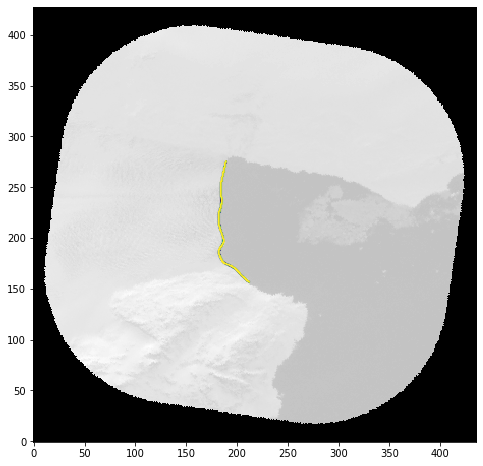

131 out of 152 R_LC08_L1TP_232017_20150326_20170411_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
17


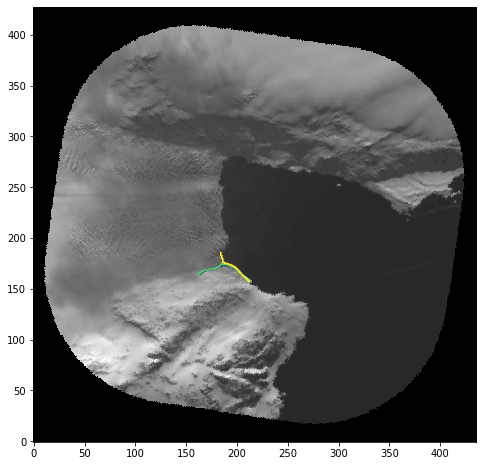

132 out of 152 R_LC08_L1TP_232017_20150630_20170407_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
4


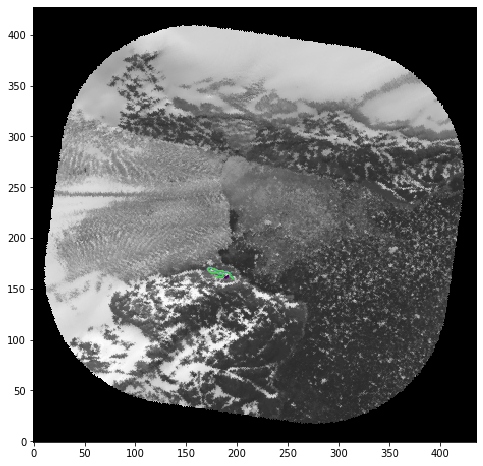

133 out of 152 R_LC08_L1TP_233017_20160911_20170321_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
34


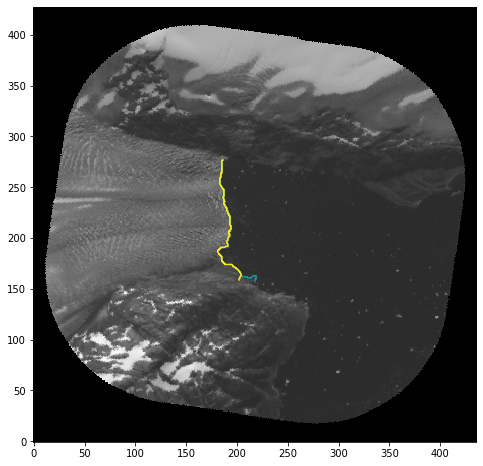

134 out of 152 R_LC08_L1TP_233017_20160927_20170320_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
40


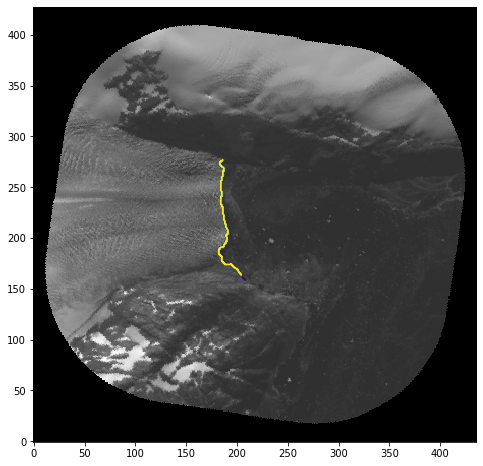

135 out of 152 R_LC08_L1TP_233017_20161013_20170319_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
14


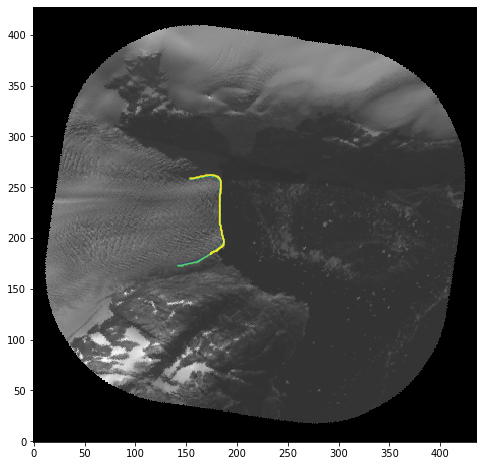

136 out of 152 R_LC08_L1TP_233017_20161029_20170319_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


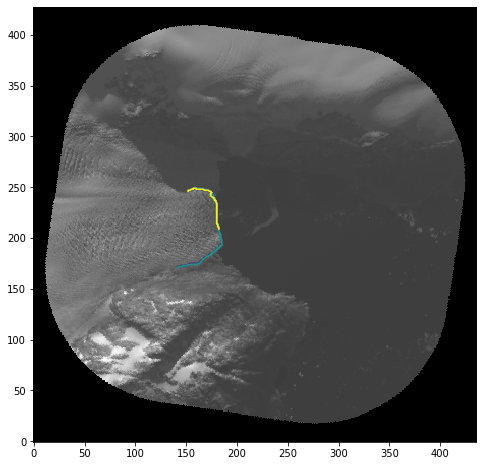

137 out of 152 R_LC08_L1TP_233017_20200314_20200325_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
2


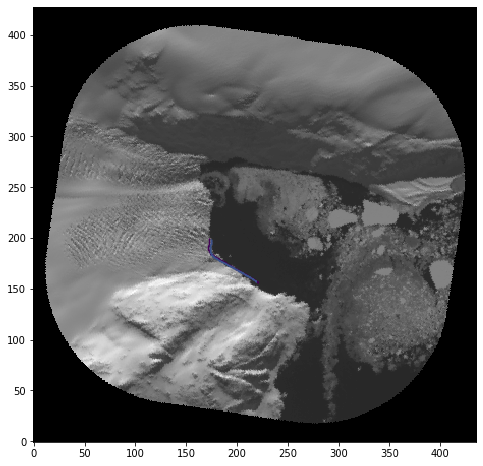

138 out of 152 R_LC08_L1TP_233017_20200501_20200501_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


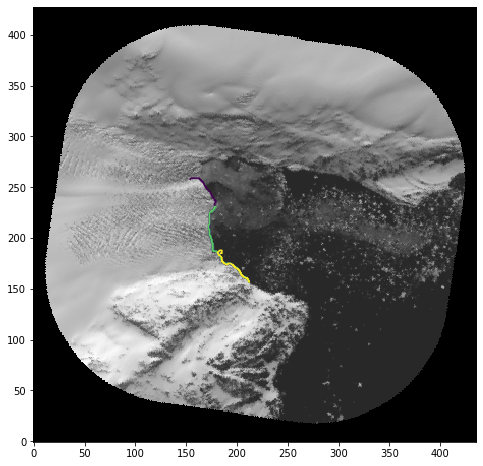

139 out of 152 R_LC08_L1TP_233017_20200501_20200509_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
30


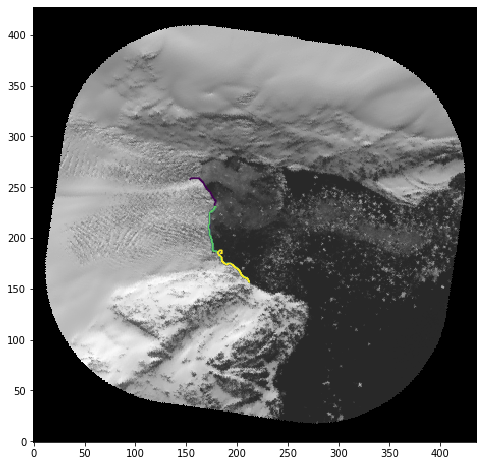

140 out of 152 R_LC08_L1TP_232017_20160718_20170323_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
36


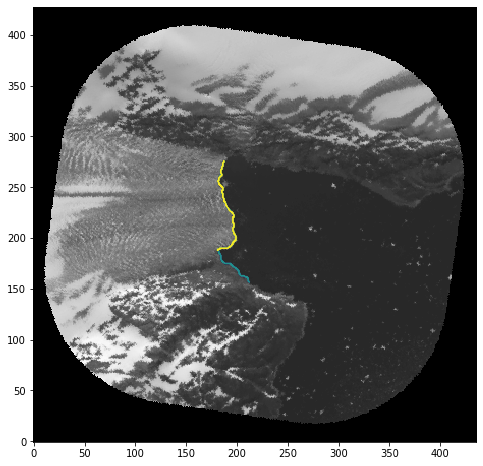

141 out of 152 R_LC08_L1TP_232017_20160920_20170321_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


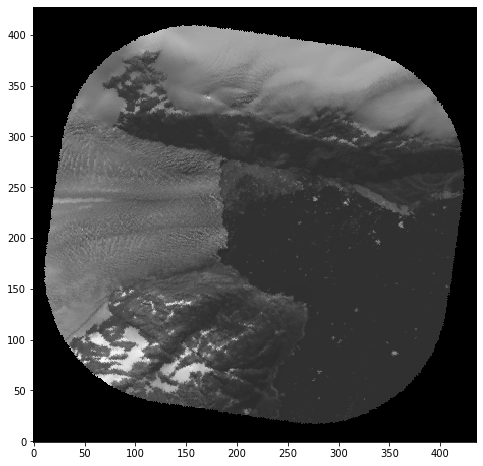

142 out of 152 R_LC08_L1TP_232017_20161022_20170319_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.5

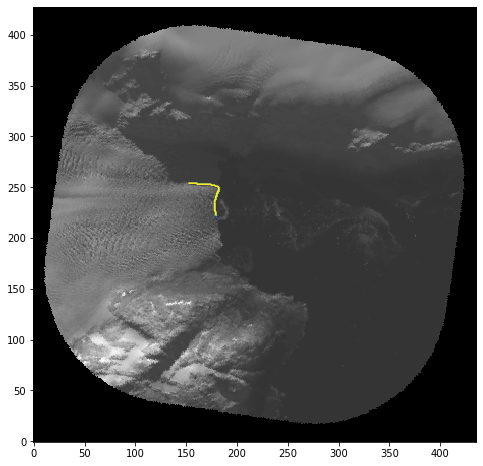

143 out of 152 R_LC08_L1TP_232017_20170315_20170328_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
12


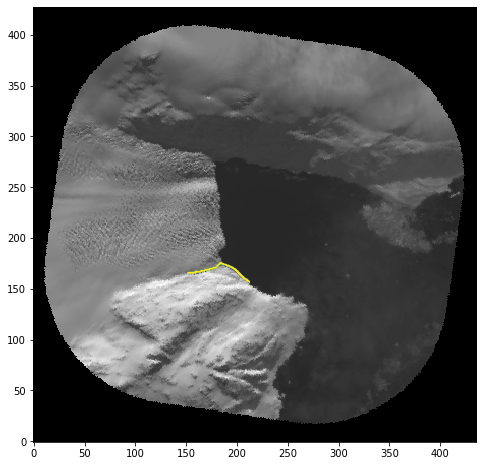

144 out of 152 R_LC08_L1TP_233017_20190616_20190617_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
11


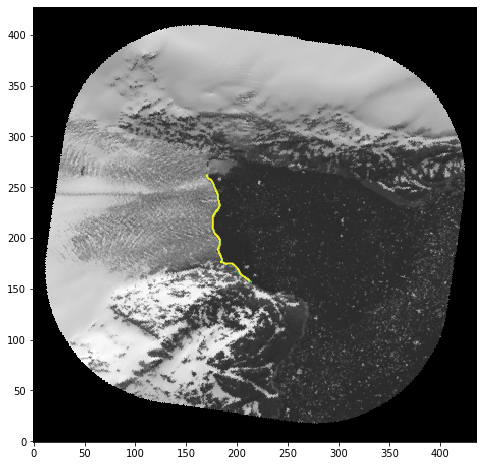

145 out of 152 R_LC08_L1TP_233017_20190616_20190620_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
11


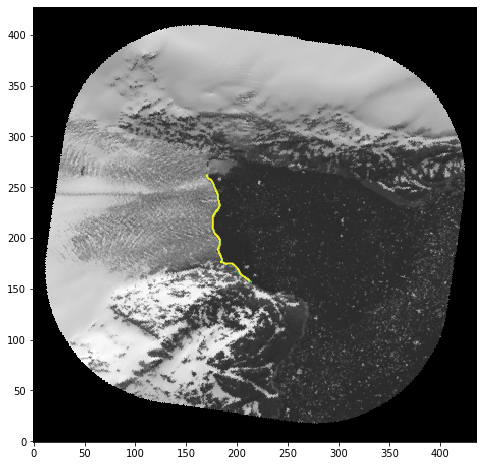

146 out of 152 R_LC08_L1TP_233017_20190718_20190718_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
29


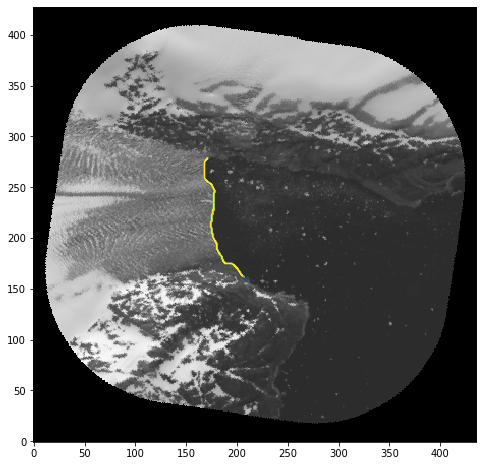

147 out of 152 R_LC08_L1TP_232017_20190711_20190719_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
3


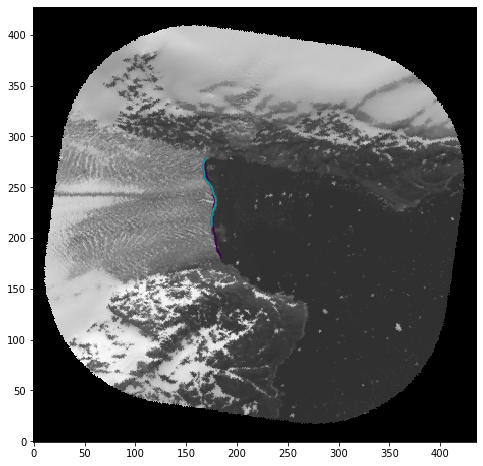

148 out of 152 R_LC08_L1TP_232017_20190828_20190828_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
39


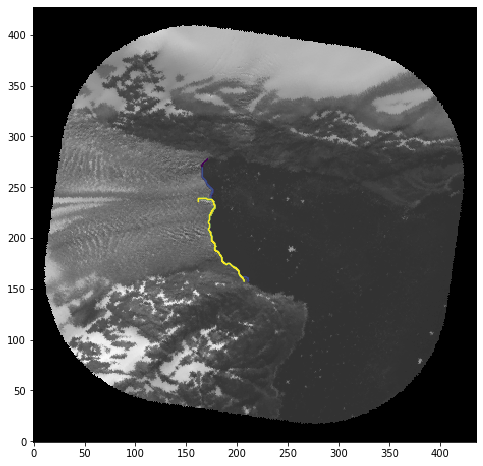

149 out of 152 R_LC08_L1TP_232017_20190828_20190903_01_T1_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
38


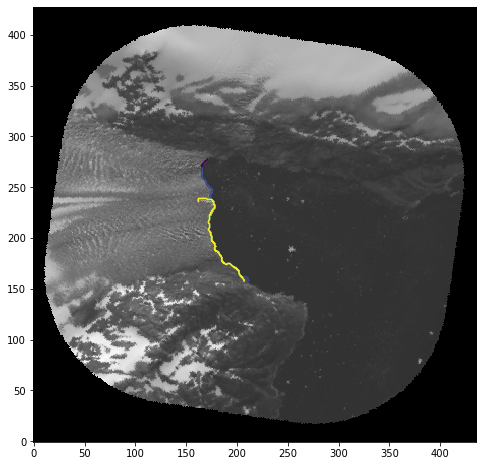

150 out of 152 R_LC08_L1TP_232017_20181028_20181029_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
22


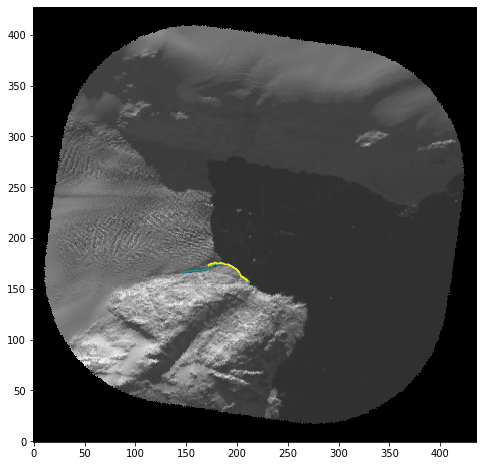

151 out of 152 R_LC08_L1TP_232017_20181129_20181129_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351


/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:861: RuntimeWarning: invalid value encountered in true_divide
  dx_norm = np.divide(dx,m)
/home/jukes/automated-glacier-terminus/Xsmurf_functions.py:862: RuntimeWarning: invalid value encountered in true_divide
  dy_norm = np.divide(dy,m)


Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.59813394476642
Scale: 90.67003494209142
Scale: 97.17773729817198
Scale: 104.15251998550409
Scale: 111.62790697674419
Scale: 119.63982837614432
Scale: 128.2267931159481
Scale: 137.4300740478046
Scale: 147.29390631883476
Scale: 157.86569998583388
Scale: 169.19626788953278
Scale: 181.34006988418284
Scale: 194.35547459634395
Scale: 208.30503997100823
0


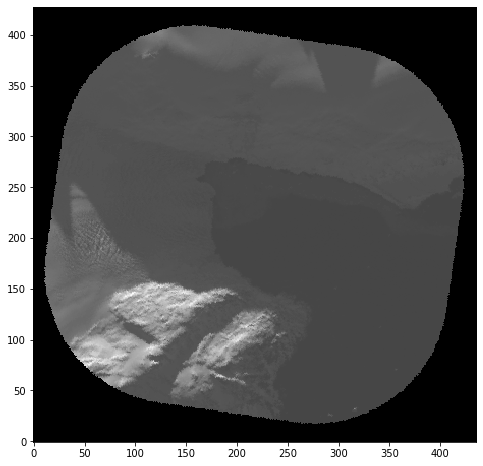

152 out of 152 R_LC08_L1TP_232017_20190305_20190305_01_RT_B8_Buffer174_PS.pgm
Scale: 6.976744186046512
Scale: 7.477489273509022
Scale: 8.014174569746757
Scale: 8.589379627987789
Scale: 9.205869144927169
Scale: 9.866606249114618
Scale: 10.5747667430958
Scale: 11.333754367761426
Scale: 12.147217162271499
Scale: 13.01906499818801
Scale: 13.953488372093023
Scale: 14.954978547018044
Scale: 16.02834913949351
Scale: 17.178759255975578
Scale: 18.411738289854338
Scale: 19.733212498229236
Scale: 21.149533486191604
Scale: 22.66750873552285
Scale: 24.294434324542998
Scale: 26.03812999637602
Scale: 27.906976744186046
Scale: 29.909957094036088
Scale: 32.05669827898703
Scale: 34.35751851195115
Scale: 36.823476579708675
Scale: 39.46642499645847
Scale: 42.29906697238321
Scale: 45.33501747104571
Scale: 48.58886864908599
Scale: 52.07625999275204
Scale: 55.81395348837209
Scale: 59.819914188072175
Scale: 64.11339655797406
Scale: 68.7150370239023
Scale: 73.64695315941735
Scale: 78.93284999291694
Scale: 84.5

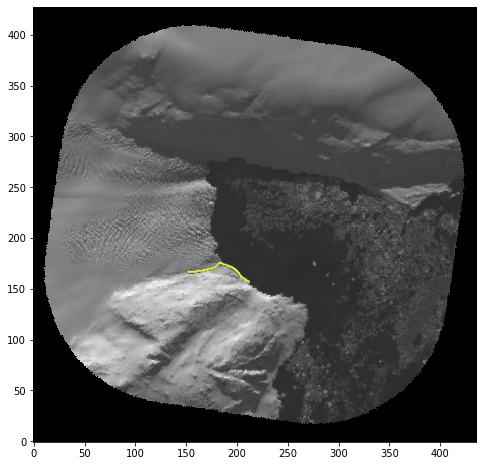

5574.571061819792 sec to process 152 images.


In [73]:
# Process all the images for the glaciers specified and show top 5 terminus chains
for BoxID in BoxIDs:
    tic()
    processed_image_path = basepath+'Box'+BoxID+'/rotated_c1/'
    imagelist = []
    for file in os.listdir(processed_image_path):
        if file.endswith('PS.pgm'):
            imagelist.append(file)
        elif file.endswith('cut.png'):
            boxfile = file
        
    # Load terminus box
    box = Image.open(processed_image_path+boxfile)
    box_array = np.array(box)[:,:,0]/255 # grab 1D slice from array and convert to binary
    print('Box raster dimensions:', box_array.shape)
    plt.imshow(box_array); plt.show()  # Display mask
    
    image_num = 1
    # process all the images
    for image in imagelist:
        img = Image.open(processed_image_path+image)
        print(str(image_num)+' out of '+str(len(imagelist))+' '+image)
        
        # WTMM
        counter = 0
        all_cmm = [] # to hold all the chains produced
        # ascend over all scales
        for iOct in np.arange(0, nOct):
            for iVox in np.arange(0, nVox):

                # calculate scale in pixels
                scale = 6/0.86*amin*2**(iOct+(iVox/nVox))
                print('Scale: '+str(scale))

                # wavelet transform
#                 [dx, dy, mm, m, a] = wtmm2d_v(img, wavelet, scale)
                [dx, dy, mm, m, a] = wtmm2d_v2(img, wavelet, scale)
#                 print('Wavelet transform done.')
                
                # emask
                masked_a = emask(box_array, a)
                masked_mm = emask(box_array, mm)
                masked_m = emask(box_array, m)
#                 print('Masking done.')

                # chain
                cmm = wtmmchains(masked_mm,masked_a,0,scale)
#                 print('Chaining done.')

                # increment
                all_cmm.extend(cmm)
                counter = counter +1 
       
        # Pick the terminus line
        # Find maximum mods and sizes for thresholding
        mods = []; sizes = []
        for chain in all_cmm:
            sizes.append(chain.size)
            mods.append(chain.linemeanmod)
        maxmod = np.nanmax(mods); maxsize = np.nanmax(sizes)
            
        mass_or_size = []
        passed_chains = []
        passcount = 0
        for chain in all_cmm:
            if chain.linemeanmod > mod_thresh*maxmod: # only chains that pass the mod threshold
#                 if chain.size > size_thresh*maxsize: # only chains that pass the size threshold
                if chain.size > size_thresh*np.sqrt(len(box_array[box_array > 0])):
                    [passedargs, argfrac] = filter_args(chain.args, np.pi/3) # identify the left & right-pointing args
                    if argfrac > arg_thresh: # only chains that pass the orientation threshold
                        if metric == 0:
                            mass_or_size.append(chain.mass)
                        elif metric == 1:
                            mass_or_size.append(chain.scaledmass)
                        else:
                            mass_or_size.append(chain.size)
                        passcount += 1
                        passed_chains.append(chain)
        print(passcount)
        
        # sort by mass or size:
        zipped = zip(mass_or_size, passed_chains)              
        top_chains = sorted(zipped,reverse=True,
                            key=lambda zipped: zipped[0])[:5] # sort chains that passed
        
        # visualize top chains:
        colors = pl.cm.viridis(np.linspace(0,1,5)) # generate colors using a colormap
        plt.figure(figsize=(8,8))
        plt.imshow(np.array(img), aspect='equal', cmap = 'gray')
#         plt.xlim([0, m.shape[1]])
#         plt.ylim([0, m.shape[0]])
        plt.gca().set_aspect('equal'); plt.gca().invert_yaxis()
        for k in range(0, len(top_chains)): # plot chains (purple = top, yellow = 5th)
            plt.plot(top_chains[len(top_chains)-1-k][1].ix, 
                     top_chains[len(top_chains)-1-k][1].iy, 's-', color=colors[k],markersize=0.1)
        plt.show()
        
        # pickle the chains?
        
#         print(toc())
        image_num = image_num +1
        
    print(str(toc())+' sec to process '+str(len(imagelist))+' images.' )

# 1 image at a time

## 1) Load terminus box

(428, 436)


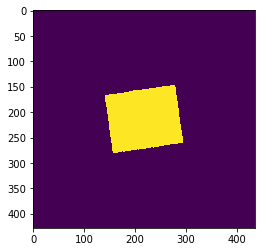

In [6]:
# use terminus box raster to mask out external chains
# box = Image.open(basepath+'Box277/rotated_c1/R_Box277_raster_cut.png')
# box = Image.open(basepath+'R_Box174_raster_cut.png')
box = Image.open(basepath+'Box174/rotated_c1/R_Box174_raster_cut.png')
box_array = np.array(box)[:,:,0]/255 # grab 1D slice from array and convert to binary
print(box_array.shape)
plt.imshow(box_array); plt.show()  # Display mask

## 2) Open image(s) for testing:

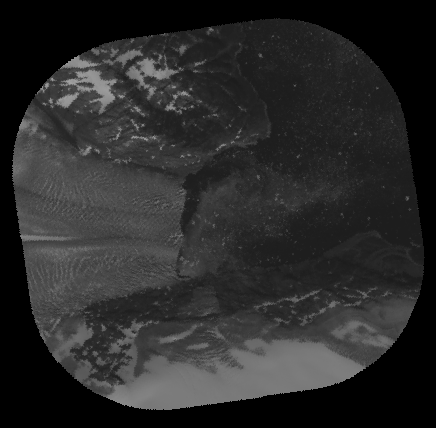

In [23]:
# # open glacier image for testing
# img  = Image.open(basepath+'Box277/rotated_c1/R_LC08_L1GT_001014_20180519_20180520_01_RT_B8_Buffer277_PS.pgm')
img = Image.open(basepath+'Box174/rotated_c1/R_LC08_L1TP_233017_20170813_20170814_01_RT_B8_Buffer174_PS.pgm')
# img = Image.open(basepath+'R_LC08_L1TP_233017_20170813_20170814_01_RT_B8_Buffer174_PS.pgm')
# OR generate circle image
# img = generate_circle_image(100, 436, 428)

img

## 3) Run wtmm2d and show outputs:

In [24]:
# [dx,dy,F,f,gx,gy] = wtmm2d(img,'gauss',10)
[dx,dy,mm,m,a] = wtmm2d_v2(img,'gauss',10) # scale = 200 pixels

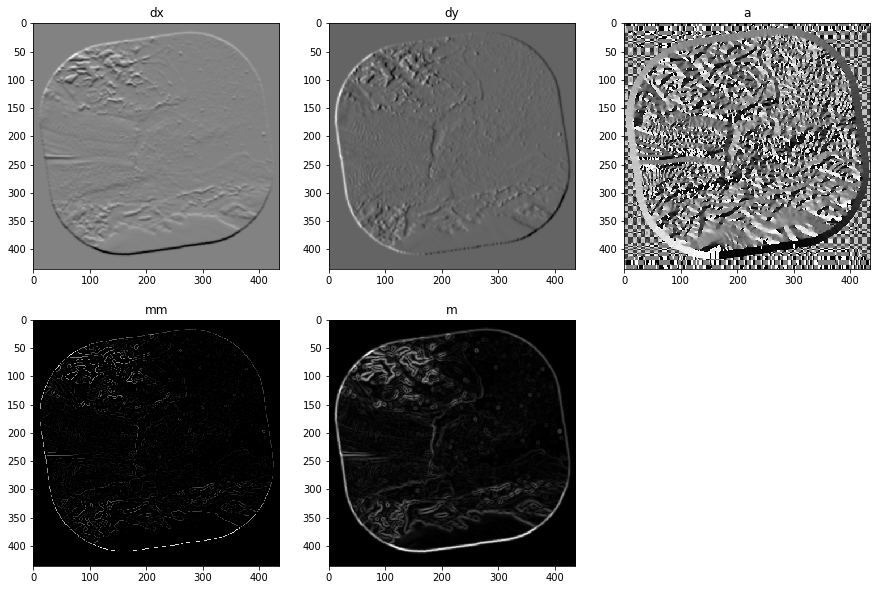

In [25]:
# Visualize outputs from wtmm2d:
fig, axs = plt.subplots(2,3,figsize=(15,10))
axs[0,0].imshow(dx, aspect='equal', cmap = 'gray', interpolation='none'); axs[0,0].set_title('dx') # x gradient
axs[0,1].imshow(dy, aspect='equal', cmap = 'gray', interpolation='none'); axs[0,1].set_title('dy') # y gradient

axs[0,2].imshow(a, aspect='equal', cmap = 'gray', interpolation='none'); axs[0,2].set_title('a') # argument            
axs[1,0].imshow(mm, aspect='equal', cmap = 'gray', interpolation='none', vmin = np.min(mm), vmax = np.max(m)); 
axs[1,0].set_title('mm') # modulus maxima (interpolated)
axs[1,1].imshow(m, aspect='equal', cmap = 'gray', interpolation='none',vmin = np.min(mm), vmax = np.max(m));
axs[1,1].set_title('m') # modulus
axs[-1, -1].axis('off')

# Image.fromarray(mm).save('mm.tif')   
# Image.fromarray(m).save('m.tif')   

# plt.savefig('glacier_WTMM_test.png',dpi=200)
plt.show()

## 4) Mask using terminus box - emask

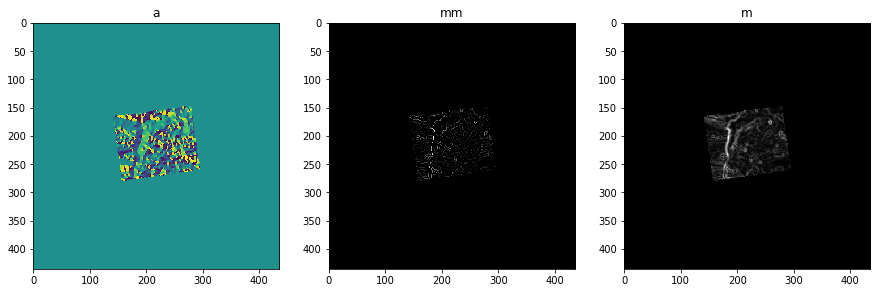

In [26]:
# Mask
masked_a = emask(box_array, a)
masked_mm = emask(box_array, mm)
masked_m = emask(box_array, m)

# Visualize masked outputs from wtmm2d:
fig, axs = plt.subplots(1,3,figsize=(15,10))

axs[0].imshow(masked_a, aspect='equal', cmap = 'viridis', interpolation='none'); axs[0].set_title('a')              
axs[1].imshow(masked_mm, aspect='equal', cmap = 'gray', interpolation='none', vmin = np.min(masked_mm), vmax = np.max(masked_mm)); 
axs[1].set_title('mm')
axs[2].imshow(masked_m, aspect='equal', cmap = 'gray', interpolation='none',vmin = np.min(masked_m), vmax = np.max(masked_m));
axs[2].set_title('m')
# plt.savefig('glacier_WTMM_test.png',dpi=200)
plt.show()

## 5) Chain remaining mms

In [36]:
cmm = wtmmchains(masked_mm,masked_a,1,10) # chain at a specified scale

In [37]:
cmm_passed = []
# Filter chains
for j in range(0, len(cmm)):
    if cmm[j].size > 0:
        cmm_passed.append(cmm[j])

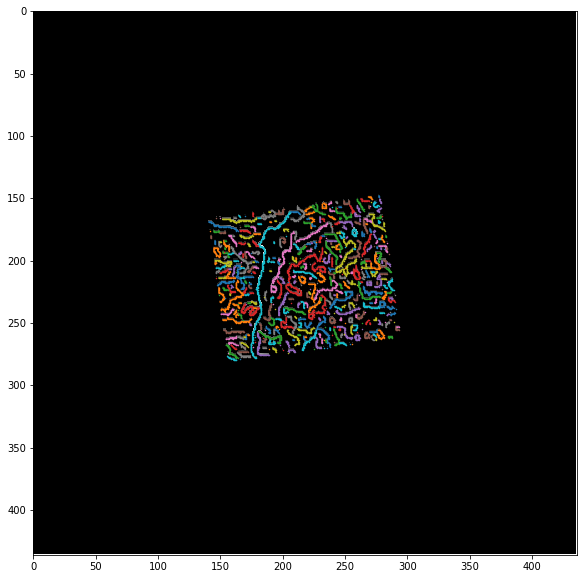

In [38]:
plt.figure(figsize=(10,10))
plt.imshow(masked_mm,cmap='gray')
plt.xlim([0, mm.shape[1]])
plt.ylim([0, mm.shape[0]])
plt.gca().set_aspect('equal'); plt.gca().invert_yaxis()
    
for k in range(0, len(cmm_passed)):
    plt.plot(cmm_passed[k].ix, cmm_passed[k].iy, 's-', markersize=0.5)
plt.show()

In [35]:
# len(cmm_passed)

## 6) Use thresholds on chain properties to pick the glacier terminus chain

In [43]:
# set filtering order (M = linemeanmod, S = size, A = argument)
order = '_MSA'
size_thresh = 0.4 # Size percentile across all images
mod_thresh = 0.7 # Linemeanmod percentile across all images
arg_thresh = 0.1 # left-right argument fraction
metric = 1 # 0 = mass, 1 = scaledmass, 2 = size

In [44]:
mass_or_size = []
passed_chains = []
for chain in all_cmm:
    if chain.linemeanmod > mod_thresh: # only chains that pass the mod threshold
        if chain.size > size_thresh: # only chains that pass the size threshold
            [passedargs, argfrac] = filter_args(chain.args, np.pi/3) # identify the left & right-pointing args
            if argfrac > arg_thresh: # only chains that pass the orientation threshold
                if metric == 0:
                    mass_or_size.append(chain.mass)
                elif metric == 1:
                    mass_or_size.append(chain.scaled_mass)
                else:
                    mass_or_size.append(chain.size)
                passed_chains.append(chain)

AttributeError: 'chain' object has no attribute 'scaled_mass'

In [45]:
top_chains = sorted(zip(mass_or_size, passed_chains),reverse=True)[:5] # sort chains that passed

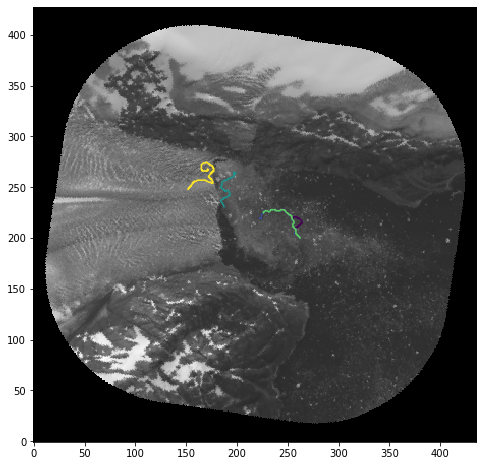

In [42]:
# visualize top chains:
colors = pl.cm.viridis(np.linspace(0,1,5)) # generate colors using a colormap
plt.figure(figsize=(8,8))
plt.imshow(np.array(img), aspect='equal', cmap = 'gray')
plt.gca().set_aspect('equal'); plt.gca().invert_yaxis()
for k in range(0, len(top_chains)):
    plt.plot(top_chains[k][1].ix, top_chains[k][1].iy, 's-', color=colors[k],markersize=0.1)
            
plt.show()